<H1>PROJET HAI923I - 2023-2024</H1>

**Membres du groupe :**

- CRISTA Allan
- EFTIMOV David
- MBELO NDRIAMANAMPY Sandratra
- ROUQUAIROL Lucas

<H1> Les jeux de données pour le projet </H1>

Dans ce notebook nous présentons les jeux de données utilisés pour le projet. Nous proposons également des fonctions pour permettre de pouvoir facilement les données.   

Il n'y a donc plus qu'à chercher les meilleurs modèles et à répondre aux questions de l'énoncé du projet.   

Bon courage !

ps : il y a trois jeux de données et ils sont très différents donc attention vous aurez peut être 3 modèles différents.

# **Installation**



Avant de commencer, il est nécessaire de déjà posséder dans son environnement toutes les librairies utiles. Dans la seconde cellule nous importons toutes les librairies qui seront utiles à ce notebook. Il se peut que, lorsque vous lanciez l'éxecution de cette cellule, une soit absente. Dans ce cas il est nécessaire de l'installer. Pour cela dans la cellule suivante utiliser la commande :  

*! pip install nom_librairie*  

**Attention :** il est fortement conseillé lorsque l'une des librairies doit être installer de relancer le kernel de votre notebook.

**Remarque :** même si toutes les librairies sont importées dès le début, les librairies utiles pour des fonctions présentées au cours de ce notebook sont ré-importées de manière à indiquer d'où elles viennent et ainsi faciliter la réutilisation de la fonction dans un autre projet.



In [ ]:
# utiliser cette cellule pour installer les librairies manquantes
# pour cela il suffit de taper dans cette cellule : !pip install nom_librairie_manquante
# d'exécuter la cellule et de relancer la cellule suivante pour voir si tout se passe bien
# recommencer tant que toutes les librairies ne sont pas installées ...

# sous Colab il faut déjà intégrer ces deux librairies

#!pip install umap-learn[plot]
#!pip install holoviews
#!pip install -U ipykernel

# eventuellement ne pas oublier de relancer le kernel du notebook

In [ ]:
# Importation des différentes librairies utiles pour le notebook

#Sickit learn met régulièrement à jour des versions et
#indique des futurs warnings.
#ces deux lignes permettent de ne pas les afficher.
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

# librairies générales
import pickle
import pandas as pd
from scipy.stats import randint
import numpy as np
import string
import time
import base64
import re
import sys
import copy
import random
from numpy import mean
from numpy import std


# librairie affichage
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import plotly.graph_objs as go
import plotly.offline as py

from sklearn.metrics import confusion_matrix
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score

# TensorFlow et keras
import tensorflow as tf
from keras import layers
from keras import models
from keras import optimizers
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import img_to_array, load_img
from keras.callbacks import ModelCheckpoint, EarlyStopping
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.preprocessing import image
from tqdm import tqdm
from keras.models import load_model
from sklearn.model_selection import KFold
from keras.datasets import fashion_mnist
from tensorflow.keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPooling2D
from keras.layers import Dense
from keras.layers import Flatten
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import Adam
import os
from os import listdir
from os.path import isfile, join
import cv2
import glob

In [ ]:
def plot_curves_confusion (history,confusion_matrix,class_names):
  plt.figure(1,figsize=(16,6))
  plt.gcf().subplots_adjust(left = 0.125, bottom = 0.2, right = 1,
                          top = 0.9, wspace = 0.25, hspace = 0)

  # division de la fenêtre graphique en 1 ligne, 3 colonnes,
  # graphique en position 1 - loss fonction

  plt.subplot(1,3,1)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['Training loss', 'Validation loss'], loc='upper left')
  # graphique en position 2 - accuracy
  plt.subplot(1,3,2)
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['Training accuracy', 'Validation accuracy'], loc='upper left')

  # matrice de correlation
  plt.subplot(1,3,3)
  sns.heatmap(conf,annot=True,fmt="d",cmap='Blues',xticklabels=class_names, yticklabels=class_names)# label=class_names)
  # labels, title and ticks
  plt.xlabel('Predicted', fontsize=12)
  #plt.set_label_position('top')
  #plt.set_ticklabels(class_names, fontsize = 8)
  #plt.tick_top()
  plt.title("Correlation matrix")
  plt.ylabel('True', fontsize=12)
  #plt.set_ticklabels(class_names, fontsize = 8)
  plt.show()

def plot_curves(histories, printk=True):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    colors = ['blue', 'orange']  # Couleurs pour les courbes Train et Validation
    labels = ['Train', 'Validation']

    for k, history in enumerate(histories, start=1):
        # Courbe de loss
        ax1.plot(history.history['loss'], color=colors[0])
        ax1.plot(history.history['val_loss'], color=colors[1])

        # Courbe d'accuracy
        ax2.plot(history.history['accuracy'], color=colors[0])
        ax2.plot(history.history['val_accuracy'], color=colors[1])

        if printk:
            # Ajout de la valeur de k sur les courbes
            ax1.text(len(history.history['loss']) - 1, history.history['loss'][-1], f'Fold={k}', ha='right', va='bottom', color='black')
            ax1.text(len(history.history['val_loss']) - 1, history.history['val_loss'][-1], f'Fold={k}', ha='right', va='top', color='black')
            ax2.text(len(history.history['accuracy']) - 1, history.history['accuracy'][-1], f'Fold={k}', ha='right', va='bottom', color='black')
            ax2.text(len(history.history['val_accuracy']) - 1, history.history['val_accuracy'][-1], f'Fold={k}', ha='right', va='top', color='black')

    ax1.set_title('Loss')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend(labels)

    ax2.set_title('Accuracy')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend(labels)

    plt.show()

Pour pouvoir sauvegarder sur votre répertoire Google Drive, il est nécessaire de fournir une autorisation. Pour cela il suffit d'éxecuter la ligne suivante et de saisir le code donné par Google.

In [ ]:
# pour monter son drive Google Drive local
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


Corriger éventuellement la ligne ci-dessous pour mettre le chemin vers un répertoire spécifique dans votre répertoire Google Drive :

In [ ]:
import sys
my_local_drive='/content/gdrive/My Drive/Colab Notebooks/ImageClassification'
# Ajout du path pour les librairies, fonctions et données
sys.path.append(my_local_drive)
# Se positionner sur le répertoire associé
%cd $my_local_drive

%pwd

/content/gdrive/.shortcut-targets-by-id/1khXThnAZFaLo2fwlft5SDQ7AZ8hLbU_B/ImageClassification


'/content/gdrive/.shortcut-targets-by-id/1khXThnAZFaLo2fwlft5SDQ7AZ8hLbU_B/ImageClassification'

####Les jeux de données


Récupération des jeux de données :      

In [ ]:
# !wget https://www.lirmm.fr/~poncelet/Ressources/Tiger-Fox-Elephant.zip

In [ ]:
# import zipfile
# with zipfile.ZipFile("Tiger-Fox-Elephant.zip","r") as zip_ref:
#     zip_ref.extractall("Data_Project")


Il y a trois jeux de données différents : des tigres, des éléphants et des renards. Pour chacun d'entre eux il y a un ensemble d'images positive et un ensemble d'images négatives. Par exemple dans le répertoire *tiger* il n'y a que des images de tigre et dans le répertoire *Tiger_negative_class* il n'y a que des images d'animaux qui ne correspondent pas à des tigres.   

Le code ci-dessous permet de visualiser quelques images contenues dans le répertoire *tiger*.

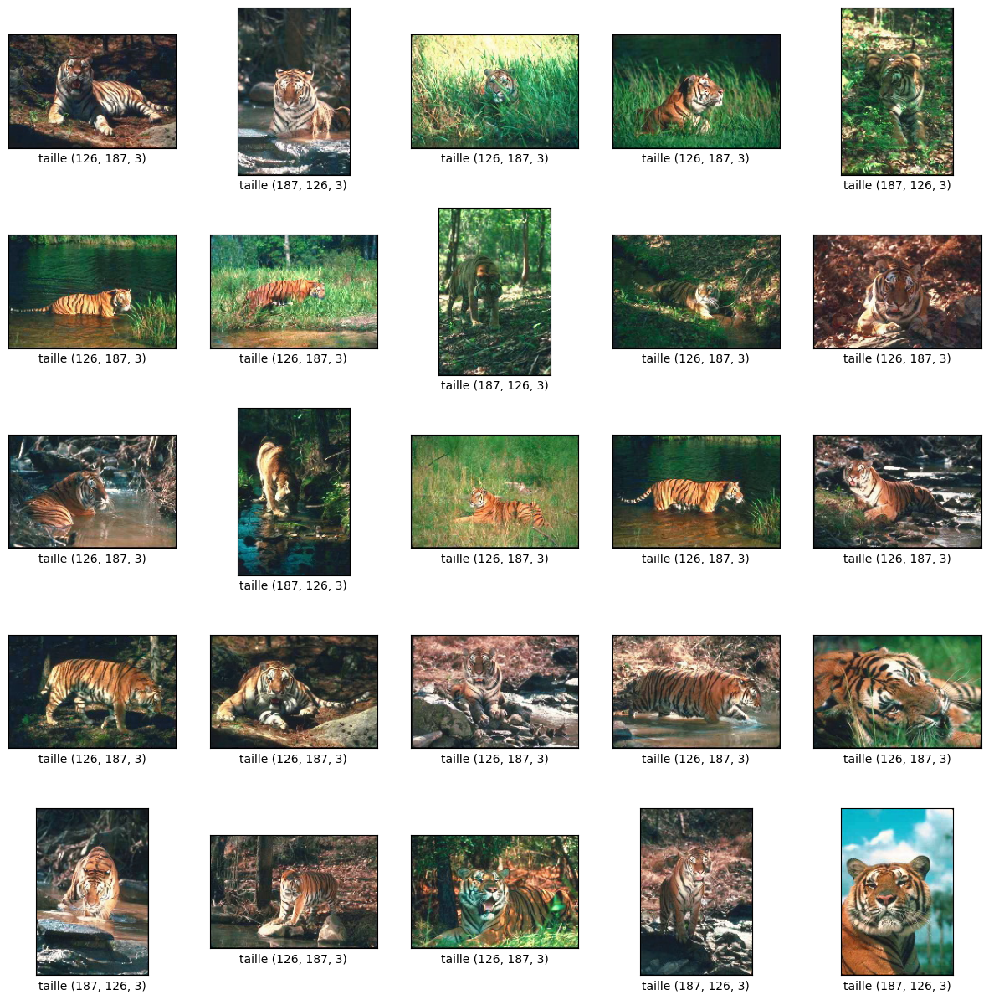

In [ ]:
mypath='Data_Project/Tiger-Fox-Elephant/tiger'
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
images = np.empty(len(onlyfiles), dtype=object)
for n in range(0, len(onlyfiles)):
  images[n] = cv2.imread( join(mypath,onlyfiles[n]) )


COLUMNS = 25 # Nombre d'images à afficher

plt.figure(figsize=(15,15))
for i in range(COLUMNS):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # cv2 lit met les images en BGR et matplotlib lit du RGB
    # il faut donc convertir pour afficher les bonnes couleurs
    images[i] = cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB)
    plt.imshow(images[i],cmap=plt.cm.binary)
    plt.xlabel('taille ' + str(images[i].shape))

Nous pouvons constater que les images ne sont pas de la même taille. Il faut donc les convertir. Une manière simple de faire et de faire la conversion lors de la lecture des images : ici nous convertissons toutes les images en 124x124.

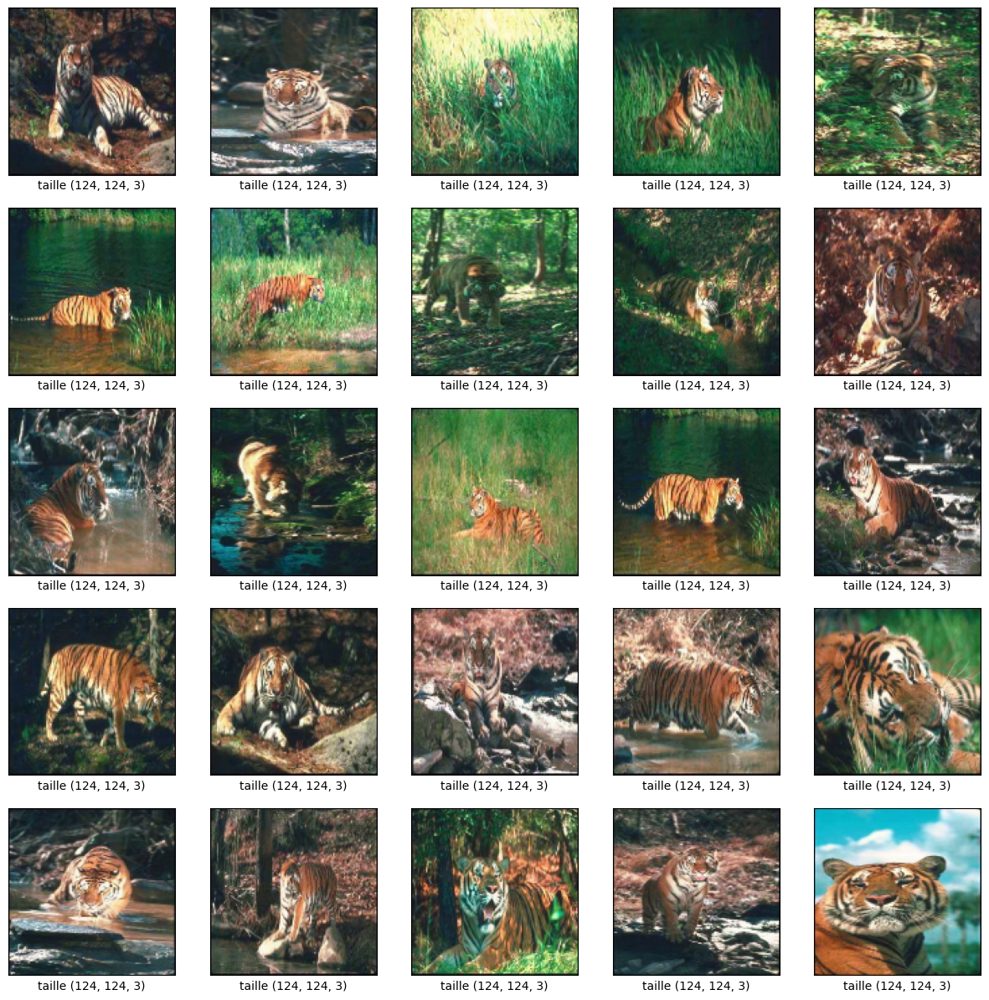

In [ ]:
IMG_SIZE=124
mypath='Data_Project/Tiger-Fox-Elephant/tiger'
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
images = np.empty(len(onlyfiles), dtype=object)
for n in range(0, len(onlyfiles)):
  images[n] = cv2.imread( join(mypath,onlyfiles[n]) )
  images[n]  = cv2.resize(images[n], (IMG_SIZE, IMG_SIZE))

plt.figure(figsize=(15,15))
for i in range(COLUMNS):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # cv2 lit met les images en BGR et matplotlib lit du RGB
    # il faut donc convertir pour afficher les bonnes couleurs
    images[i] = cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB)
    plt.imshow(images[i],cmap=plt.cm.binary)
    plt.xlabel('taille ' + str(images[i].shape))

**Créer le jeu de données**   

Actuellement pour chaque animal nous avons un répertoire qui contient des images positives et un répertoire qui contient des images négatives. Pour pouvoir créer un jeu de données nous devons obtenir X et y. Les fonctions ci-dessous permettent de générer, à partir des répertoires, un jeu de données aléatoire pour X et y.

In [ ]:
def create_training_data(path_data, list_classes):
  training_data=[]
  for classes in list_classes:
      path=os.path.join(path_data, classes)
      class_num=list_classes.index(classes)
      for img in os.listdir(path):
        try:
          img_array = cv2.imread(os.path.join(path,img), cv2.IMREAD_UNCHANGED)
          new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
          training_data.append([new_array, class_num])
        except Exception as e:
          pass
  return training_data

def create_X_y (path_data, list_classes):
      # récupération des données
      training_data=create_training_data(path_data, list_classes)
      # tri des données
      random.shuffle(training_data)
      # création de X et y
      X=[]
      y=[]
      for features, label in training_data:
        X.append(features)
        y.append(label)
      X=np.array(X).reshape(-1,IMG_SIZE, IMG_SIZE, 3)
      y=np.array(y)
      return X,y

def plot_examples(X,y):
  Xcopy = copy.deepcopy(X)
  ycopy = copy.deepcopy(y)
  plt.figure(figsize=(15,15))
  for i in range(COLUMNS):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # cv2 lit met les images en BGR et matplotlib lit du RGB
    Xcopy[i] = cv2.cvtColor(Xcopy[i], cv2.COLOR_BGR2RGB)
    plt.imshow(Xcopy[i],cmap=plt.cm.binary)
    plt.xlabel('classe ' + str(ycopy[i]))

Définition de constante globale      


In [ ]:
# constantes globales

IMG_SIZE=124
COLUMNS = 25 # Nombre d'images à afficher

Pour les tigres :

Nombre de données :  200
Taille d'une image pour connaître l'input du réseau (124, 124, 3)
Distribution des labels dans le jeu d'apprentissage


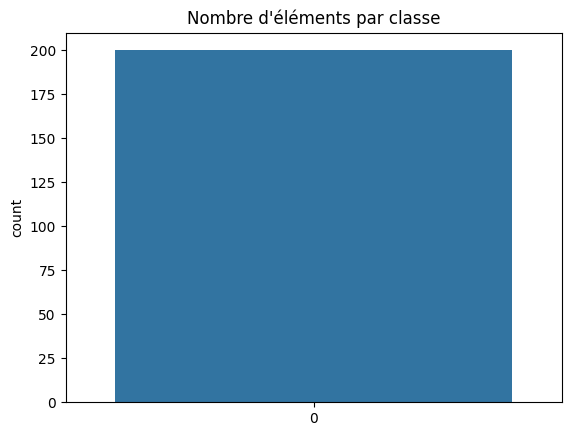

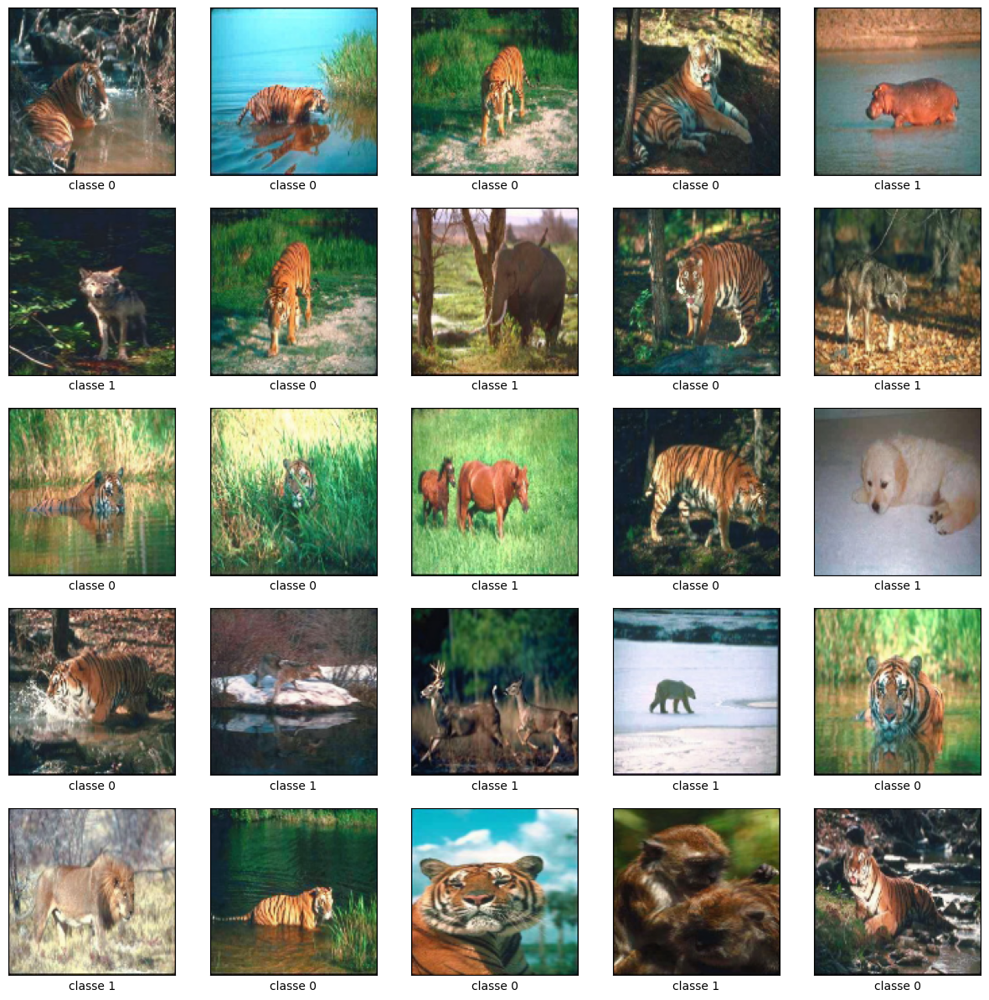

In [ ]:
my_path="Data_Project/Tiger-Fox-Elephant/"
my_classes=['tiger','Tiger_negative_class']
X,y=create_X_y (my_path,my_classes)
print ("Nombre de données : ",X.shape[0])
print ("Taille d'une image pour connaître l'input du réseau", X[0].shape)
print ("Distribution des labels dans le jeu d'apprentissage")
sns.countplot(np.array(y))
plt.title("Nombre d'éléments par classe")
# Surtout ne pas oublier de normaliser les données avec :
# affichage


# # création des datasets a augmenter
X=X.astype('float32')
X=X/255.0
plot_examples(X,y)

# Xd_tiger=copy.deepcopy(X)
# yd_tiger=copy.deepcopy(y)

# création des datasets
X_tiger=copy.deepcopy(X)
y_tiger=copy.deepcopy(y)



Pour les éléphants :     

Nombre de données :  200
Taille d'une image pour connaître l'input du réseau (124, 124, 3)
Distribution des labels dans le jeu d'apprentissage


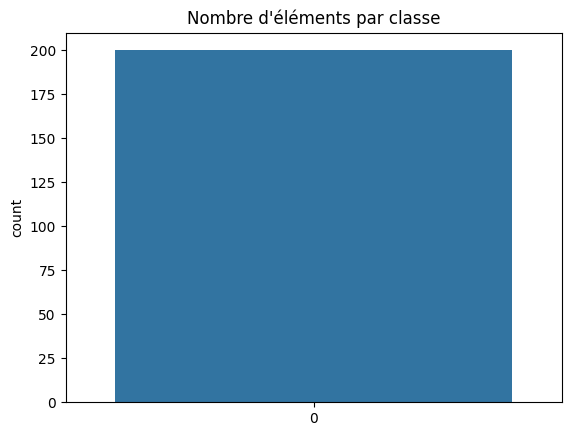

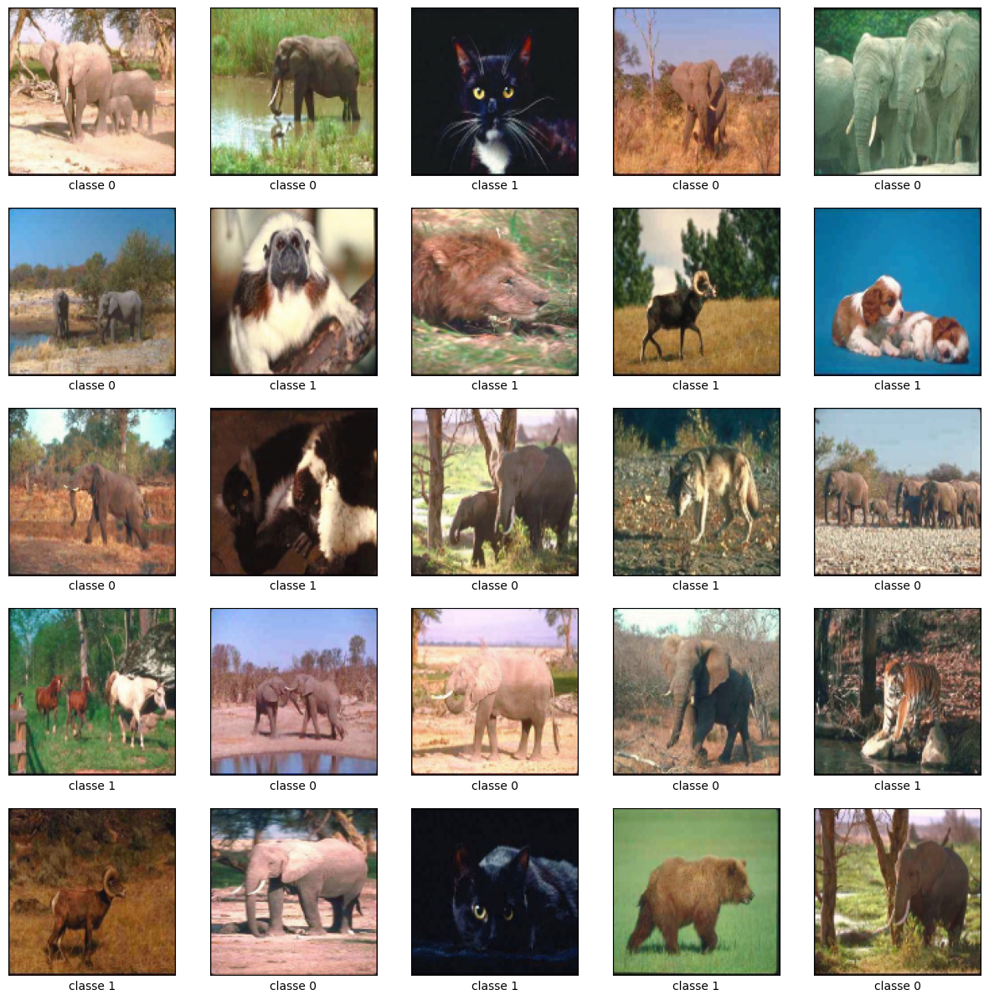

In [ ]:
my_path="Data_Project/Tiger-Fox-Elephant/"
my_classes=['elephant','Elephant_negative_class']
X,y=create_X_y (my_path,my_classes)
print ("Nombre de données : ",X.shape[0])
print ("Taille d'une image pour connaître l'input du réseau", X[0].shape)
print ("Distribution des labels dans le jeu d'apprentissage")
sns.countplot(np.array(y))
plt.title("Nombre d'éléments par classe")

# Surtout ne pas oublier de normaliser les données avec :
X=X.astype('float32')
X=X/255.0

# affichage
plot_examples(X,y)

# création des datasets
X_elephant=copy.deepcopy(X)
y_elephant=copy.deepcopy(y)



Pour les renards :     


Nombre de données :  199
Taille d'une image pour connaître l'input du réseau (124, 124, 3)
Distribution des labels dans le jeu d'apprentissage


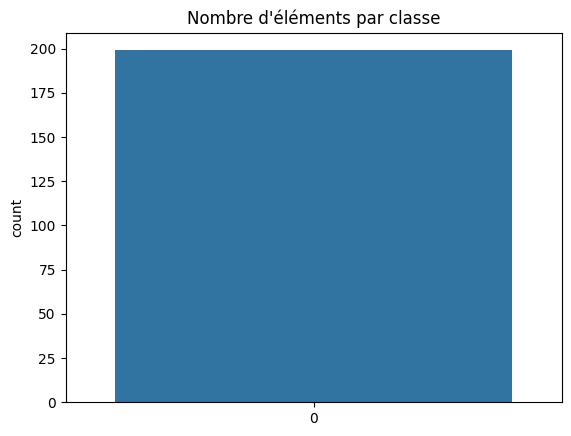

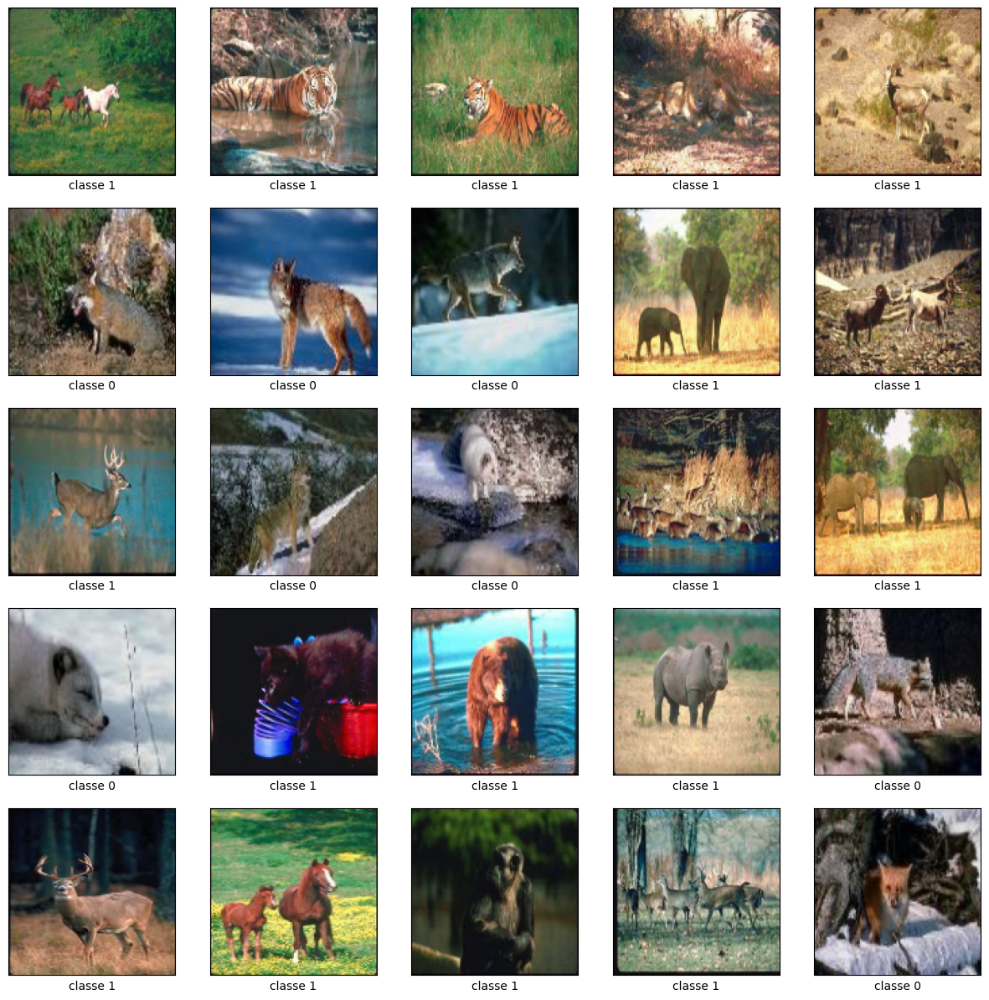

In [ ]:
my_path="Data_Project/Tiger-Fox-Elephant/"
my_classes=['fox','Fox_negative_class']
X,y=create_X_y (my_path,my_classes)
print ("Nombre de données : ",X.shape[0])
print ("Taille d'une image pour connaître l'input du réseau", X[0].shape)
print ("Distribution des labels dans le jeu d'apprentissage")
sns.countplot(np.array(y))
plt.title("Nombre d'éléments par classe")

# Surtout ne pas oublier de normaliser les données avec :
X=X.astype('float32')
X=X/255.0

# affichage
plot_examples(X,y)

# création des datasets
X_fox=copy.deepcopy(X)
y_fox=copy.deepcopy(y)



In [ ]:
!pip install umap-learn[plot]
!pip install holoviews
!pip install -U ipykernel

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.9/90.9 kB 1.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.8/55.8 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 46.0 MB/s eta 0:00:00
  Created wheel for umap-learn: filename=umap_learn-0.5.5-py3-none-any.whl size=86832 sha256=e8a5d08a4a86e889b35725f2233aea02e0a26bcdff106bff54f3cab43d17c6de
  Stored in directory: /root/.cache/pip/wheels/3a/70/07/428d2b58660a1a3b431db59b806a10da736612ebbc66c1bcc5
Successfully built umap-learn
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.6/114.6 kB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 12.8 MB/s eta 0:00:00
  Attempting uninstall: ipykernel
    Found existing installation: ipykernel 5.5.6
    Uninstalling ipykernel-5.5.6:
      Successfully uninstalled ipykernel-5.5.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are in

In [ ]:
#importation des librairies utiliser

# **Modele Baseline**

Modele Baseline, avec 1 seule couche de CNN et l’évaluer sur les différents jeux de données.

## ***Fonction d'entrainement et d'evaluation***

In [ ]:
# Creation des donnees d'entrainement et de Test
from sklearn.model_selection import train_test_split

def load_my_dataset(X, y, test_size=0.2, random_state=42):
    # Division des données en ensembles d'entraînement et de test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)

    # Retourner les ensembles d'entraînement et de test
    return X_train, y_train, X_test, y_test


def clean_data(train, test):
    # convertion d'entier en float
    train_norm = train.astype('float32')
    test_norm = test.astype('float32')
    # normalisation entre 0 et 1
    train_norm = train_norm / 255.0
    test_norm = test_norm / 255.0
    return train_norm, test_norm

*Modele Baseline*

In [ ]:
# definition du premier modèle baseline
def define_model():
    model = Sequential()
    # Convolution and pooling
    model.add(Conv2D(filters=32, kernel_size=(3, 3),
                     activation='relu', input_shape=(124, 124, 3),
                     name="Conv2D_1"))
    model.add(MaxPooling2D(pool_size=(2, 2),
                           name="Maxpooling2D_1"))

        # flatten
    model.add(Flatten(name="flatten") )

    # Partie classification
    model.add(Dense(100, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))

    # compile model
    opt = SGD(learning_rate=0.01, momentum=0.9)
    # model.compile(optimizer="adam", loss='binary_crossentropy',
    #               metrics=['accuracy'])
    model.compile(optimizer=opt, loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

*Fonction d'evaluation du model avec un KFold*

In [ ]:
import copy
from sklearn.model_selection import KFold

def evaluate_model(modelf, dataX, dataY, n_folds=5, epochs=10, batch_size=32):
    scores, histories = list(), list()
    kfold = KFold(n_folds, shuffle=True, random_state=1)

    # parcourir les splits du k-fold
    # my_model = copy.deepcopy(model)
    for train_ix, test_ix in kfold.split(dataX):

        # selection des données
        X_train, y_train, X_test, y_test = dataX[train_ix], dataY[train_ix], dataX[test_ix], dataY[test_ix]

        # ré-initialisation du modèle
        model = modelf()

        early_stopping = EarlyStopping(
        monitor='val_loss', # ou 'val_accuracy' selon ce que vous préférez surveiller
        min_delta=0.001, # changement minimal considéré comme une amélioration
        patience=10, # nombre d'époques sans amélioration après lesquelles l'entraînement sera arrêté
        verbose=1,
        mode='min' # 'min' pour la perte car nous voulons minimiser la perte
        )


        # fit du modele
        history = model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size,
                            validation_data=(X_test, y_test), verbose=1)

        # evaluate du modele
        loss, acc = model.evaluate(X_test, y_test, verbose=0)
        print('accuracy %.3f' % (acc * 100.0))
        scores.append(acc)
        histories.append(history)

    return scores, histories

In [ ]:
# fonction pour charger, transformer et évaluer le modele
# elle lance n-folds fois l'évaluation et affiche les courbes et résultats
def run_evaluation(X,y,n_folds,epochs,batch_size=32,model=define_model,printk=True):
	# load dataset
	# X_train, y_train, X_test, y_test = load_my_dataset(X,y)
	# Nettoyage et normalisation
	# X_train, X_test = clean_data(X_train, X_test)
	# define model
	modelInst = model()
	print (modelInst.summary())
	# evaluate model
	scores, histories = evaluate_model(model, X, y, n_folds,epochs,batch_size)
	plot_curves(histories, printk)
	print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores)*100, std(scores)*100, len(scores)))


## ***Tigre***

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense (Dense)               (None, 100)               11907300  
                                                                 
 dense_1 (Dense)             (None, 1)                 101       
                                                                 
Total params: 11908297 (45.43 MB)
Trainable params: 11908297 (45.43 MB)
Non-trainable params: 0 (0.00 Byte)
______________

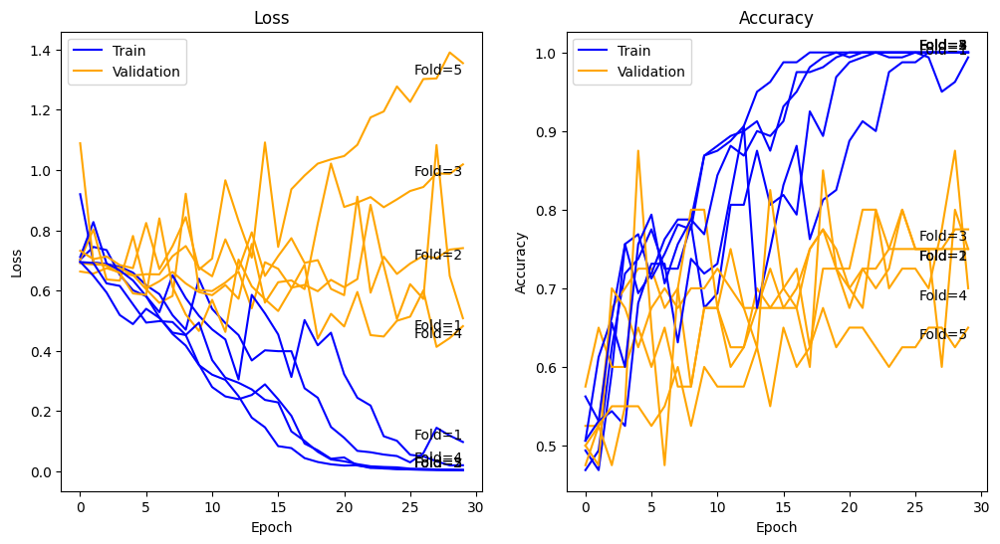

Accuracy: mean=72.500 std=4.472, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32

run_evaluation(X_tiger,y_tiger,n_folds,epochs,batch_size)

## ***Elephant***

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_12 (Dense)            (None, 100)               11907300  
                                                                 
 dense_13 (Dense)            (None, 1)                 101       
                                                                 
Total params: 11908297 (45.43 MB)
Trainable params: 11908297 (45.43 MB)
Non-trainable params: 0 (0.00 Byte)
____________

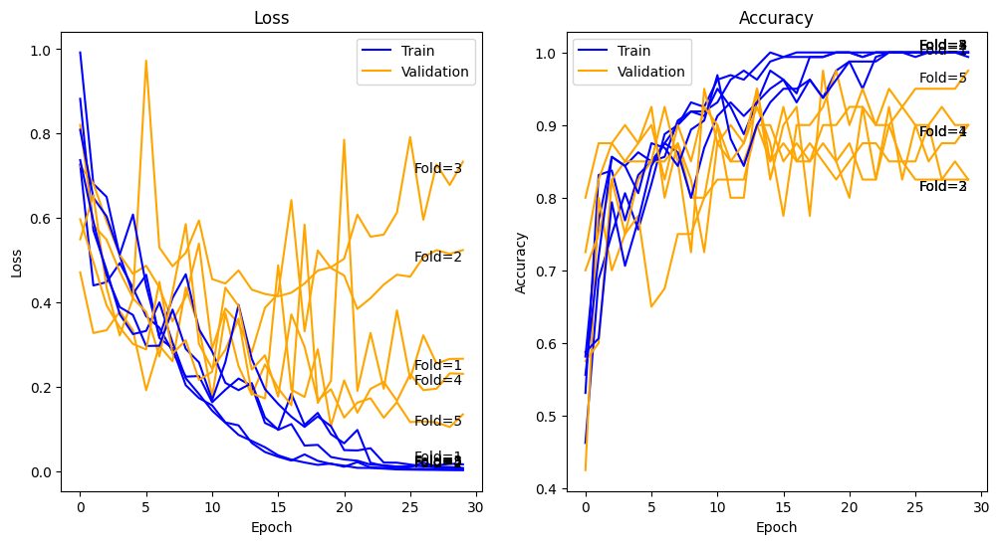

Accuracy: mean=88.500 std=5.612, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32
run_evaluation(X_elephant,y_elephant,n_folds,epochs,batch_size)

## ***Fox***

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_24 (Dense)            (None, 100)               11907300  
                                                                 
 dense_25 (Dense)            (None, 1)                 101       
                                                                 
Total params: 11908297 (45.43 MB)
Trainable params: 11908297 (45.43 MB)
Non-trainable params: 0 (0.00 Byte)
___________

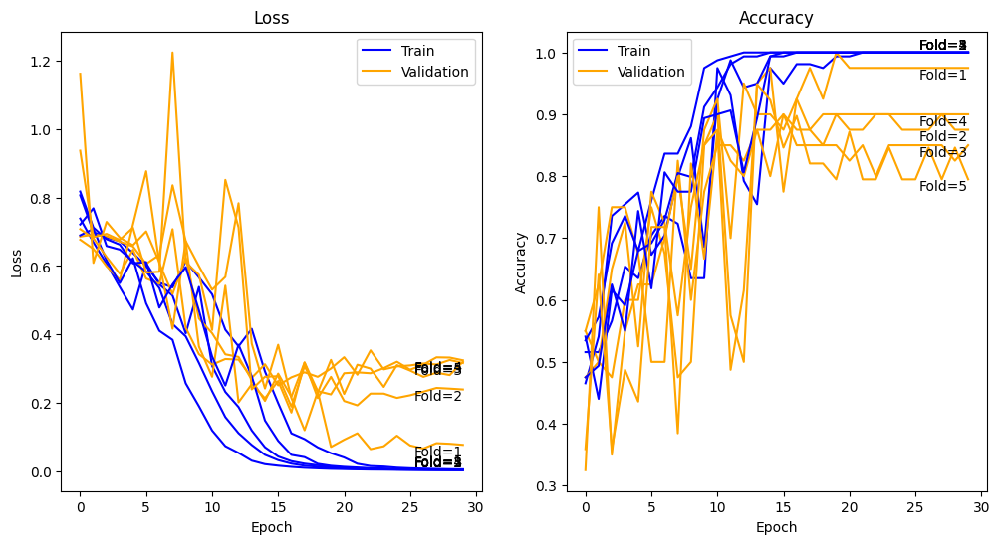

Accuracy: mean=87.897 std=5.932, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32
run_evaluation(X_fox,y_fox,n_folds,epochs,batch_size)

# **Améliorations aux modèles**

Optimisation des Modèles Antérieurs : Personnalisation de l'Architecture pour les Classes modèleTiger, modèleFox et modèleElephant. Analyse des Performances par l'évaluation croisée des modèles sur des jeux de données différents.

## ***Tigre***

il apparaît que notre ancien modèle présentait des lacunes en termes de performance, notamment dans la classification des données relatives au tigre. De plus, nous avons identifié un phénomène de surapprentissage. Pour remédier à ces problèmes, nous avons pris la décision de procéder à des améliorations. Cela inclut le changement de l'optimiseur utilisé et l'ajout de couches de dropout afin de régulariser notre modèle. Ces modifications visent à renforcer la capacité de généralisation du modèle tout en réduisant le surapprentissage, contribuant ainsi à une meilleure performance globale.

In [ ]:
# definition du premier modèle baseline
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam

def define_tiger_model():
     model = Sequential()
     # Convolution and pooling
     model.add(Conv2D(filters=32, kernel_size=(2, 2),
                      activation='relu', input_shape=(124, 124, 3),
                      name="Conv2D_1"))
     model.add(MaxPooling2D(pool_size=(2, 2),
                            name="Maxpooling2D_1"))
    #  regularisation
     model.add(MaxPooling2D(pool_size=(1, 1),
                            name="Maxpooling2D_2"))
     model.add(Dropout(0.2))
        # flatten
     model.add(Flatten(name="flatten") )

     # Partie classification
     model.add(Dense(100, activation='relu'))
     model.add(Dropout(0.2))
     model.add(Dense(1, activation='sigmoid'))

     # compile model
     opt = Adam(learning_rate=0.001)
     model.compile(optimizer=opt, loss='binary_crossentropy',
                   metrics=['accuracy'])
     return model

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 123, 123, 32)      416       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout (Dropout)           (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_36 (Dense)            (None, 100)             

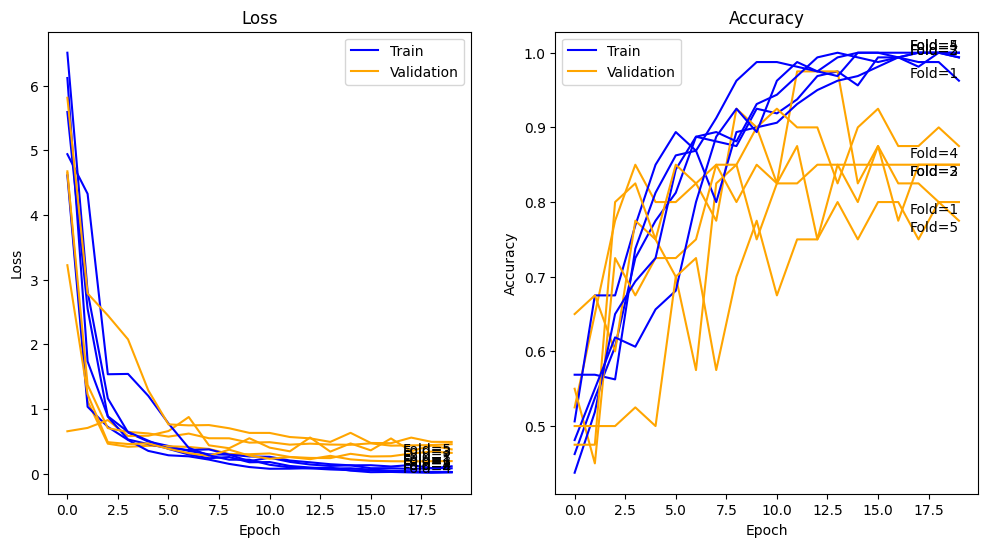

Accuracy: mean=83.000 std=3.674, n=5


In [ ]:
n_folds=5
epochs=20
batch_size=32
run_evaluation(X_tiger,y_tiger,n_folds,epochs,batch_size,define_tiger_model)

## ***Elephant***

Nous pouvons déduire de la visualisation des données que les images d'éléphants sont assez différentes des autres animaux, ce qui nous permet de nous dire que le modèle n'aura pas besoin d'être aussi complexe que les tigres et les renards. Nous pouvons observer un sur-apprentissage vers l'epoch 5, nous avons donc rajouté un dropout pour essayé de régulariser le modèle et nous avons modifier le learning rate de l'optimizer. Les courbes de validations sont plus stables mais il demeure encore du sur-apprentissage que l'on va essayer de corriger avec le data-générator

In [ ]:
# definition du premier modèle baseline
from tensorflow.keras.optimizers import Adam

def define_model_elephant_simple():
    model = Sequential()

    # Convolution and pooling
    model.add(Conv2D(filters=32, kernel_size=(3, 3),
                     activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3), # 3 car couleurs
                     name="Conv2D_1"))

    model.add(MaxPooling2D(pool_size=(2, 2),
                           name="Maxpooling2D_1"))

    model.add(Dropout(0.2))
		# flatten
    model.add(Flatten(name="flatten") )

    # Partie classification
    model.add(Dense(100, activation='relu'))

    model.add(Dense(1, activation='sigmoid')) # 1 car vrai/faux

    # compile model
    adam = Adam(learning_rate = 1e-4)
    model.compile(optimizer=adam, loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model

In [ ]:
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.regularizers import l1

def define_model_elephant():
    model = Sequential()

    # Convolution and pooling
    model.add(Conv2D(filters=32, kernel_size=(3, 3),
                     activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3), # 3 car couleurs
                     name="Conv2D_1"))

    model.add(MaxPooling2D(pool_size=(2, 2),
                           name="Maxpooling2D_1"))

    model.add(Dropout(0.2))
		# flatten
    model.add(Flatten(name="flatten") )

    # Partie classification
    model.add(Dense(100, activation='relu', kernel_regularizer=l1(1e-5)))

    model.add(Dense(1, activation='sigmoid')) # 1 car vrai/faux

    # compile model
    adam = Adam(learning_rate = 1e-5)
    model.compile(optimizer=adam, loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model

Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_60 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_80 (Dense)            (None, 100)               11907300  
                                                                 
 dense_81 (Dense)            (None, 1)                 101       
                                                     

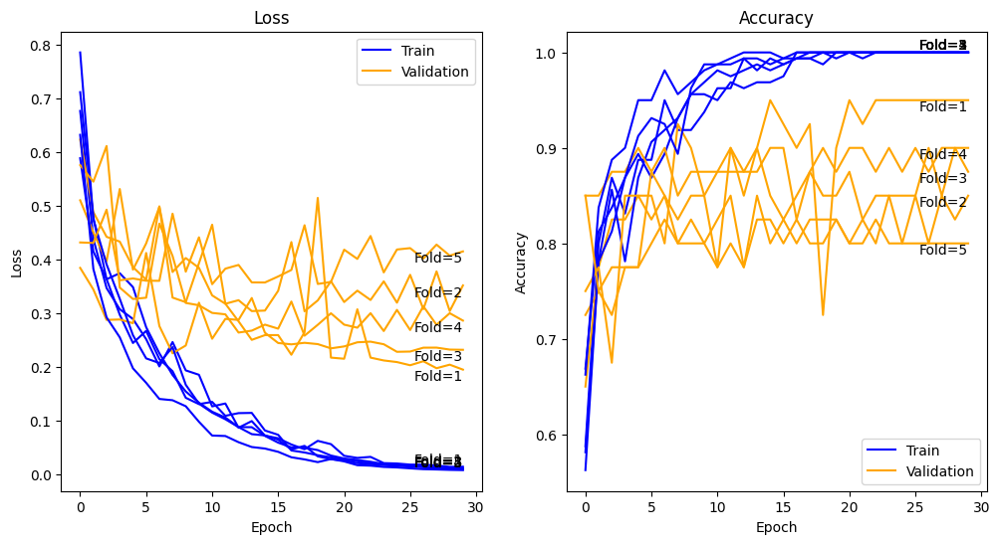

Accuracy: mean=87.500 std=5.000, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_elephant,y_elephant,n_folds,epochs,batch_size,define_model_elephant_simple)

## ***Renard***

In [ ]:
from tensorflow.keras.optimizers import Adam
from keras.regularizers import l2

def define_model_fox():
    model = Sequential()
    # Convolution and pooling
    model.add(Conv2D(filters=32, kernel_size=(3, 3),
                     activation='relu', input_shape=(124, 124, 3),
                     name="Conv2D_1"))
    model.add(MaxPooling2D(pool_size=(2,2),
                           name="Maxpooling2D_1"))

		# flatten
    model.add(Flatten(name="flatten") )

    # Partie classification
    model.add(Dense(100, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(1, activation='sigmoid'))

    # compile model
    # opt = SGD(learning_rate=0.01, momentum=0.9)
    opt = Adam(learning_rate=0.0005, beta_1=0.5)
    model.compile(optimizer="adam", loss='binary_crossentropy',
                  metrics=['accuracy'])
    # model.compile(optimizer=opt, loss='binary_crossentropy',
    #               metrics=['accuracy'])
    return model

Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_84 (Dense)            (None, 100)               11907300  
                                                                 
 dropout_30 (Dropout)        (None, 100)               0         
                                                                 
 dense_85 (Dense)            (None, 1)                 101       
                                                     

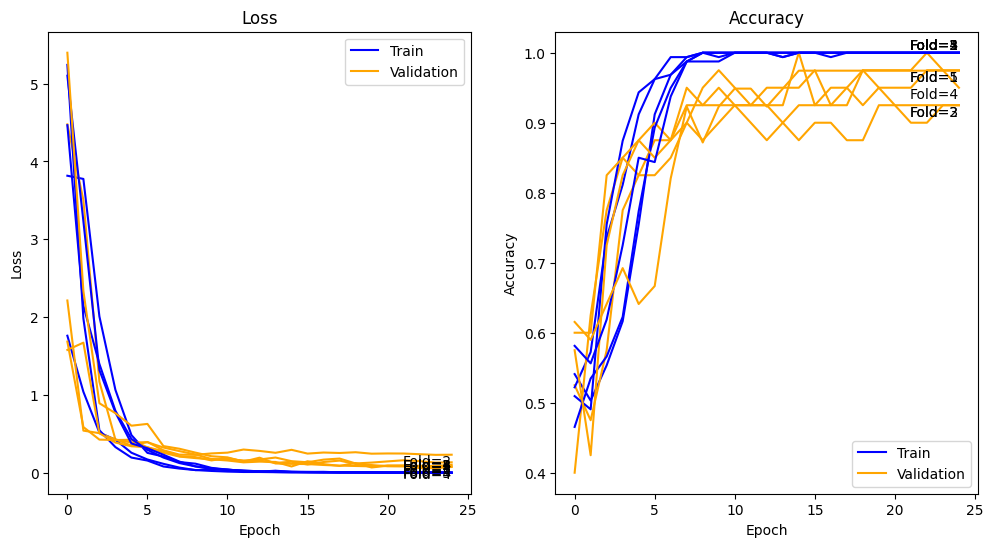

Accuracy: mean=94.987 std=2.222, n=5


In [ ]:
n_folds=5
epochs=25
batch_size=32
run_evaluation(X_fox,y_fox,n_folds,epochs, batch_size,define_model_fox)

## **Modele Tigre avec les autre animaux**

### Elephant

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 123, 123, 32)      416       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_16 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_16 (Dense)            (None, 100)              

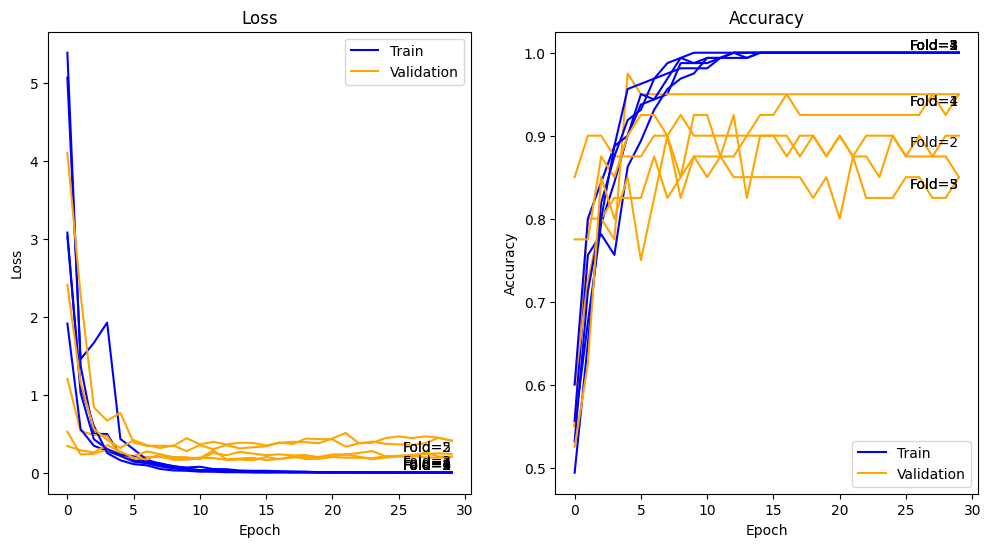

Accuracy: mean=90.000 std=4.472, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_elephant,y_elephant,n_folds,epochs,batch_size,define_tiger_model)

### Fox

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 123, 123, 32)      416       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_28 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_28 (Dense)            (None, 100)             

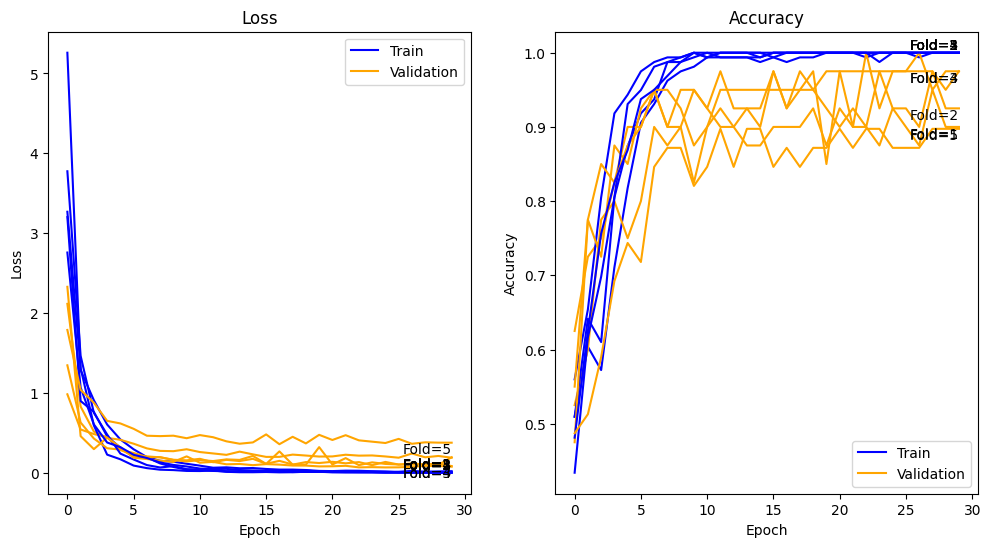

Accuracy: mean=93.449 std=3.445, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_fox,y_fox,n_folds,epochs,batch_size,define_tiger_model)

## **Modele Elephants avec les autre animaux**

### Tiger

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_7 (Dropout)         (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_14 (Dense)            (None, 100)               11907300  
                                                                 
 dense_15 (Dense)            (None, 1)                 101       
                                                      

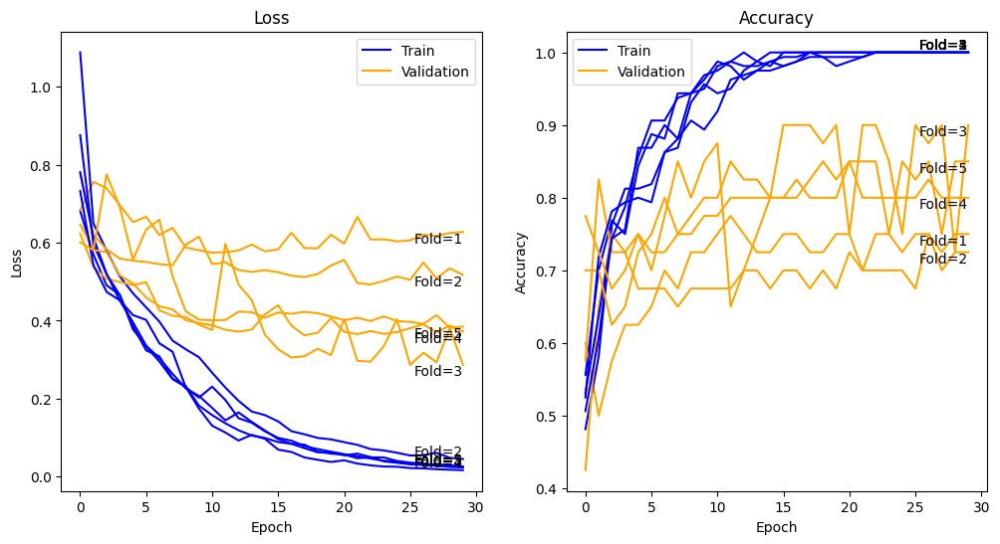

Accuracy: mean=80.500 std=6.403, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_tiger,y_tiger,n_folds,epochs,batch_size,define_model_elephant_simple)

### Fox

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_13 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_26 (Dense)            (None, 100)               11907300  
                                                                 
 dense_27 (Dense)            (None, 1)                 101       
                                                     

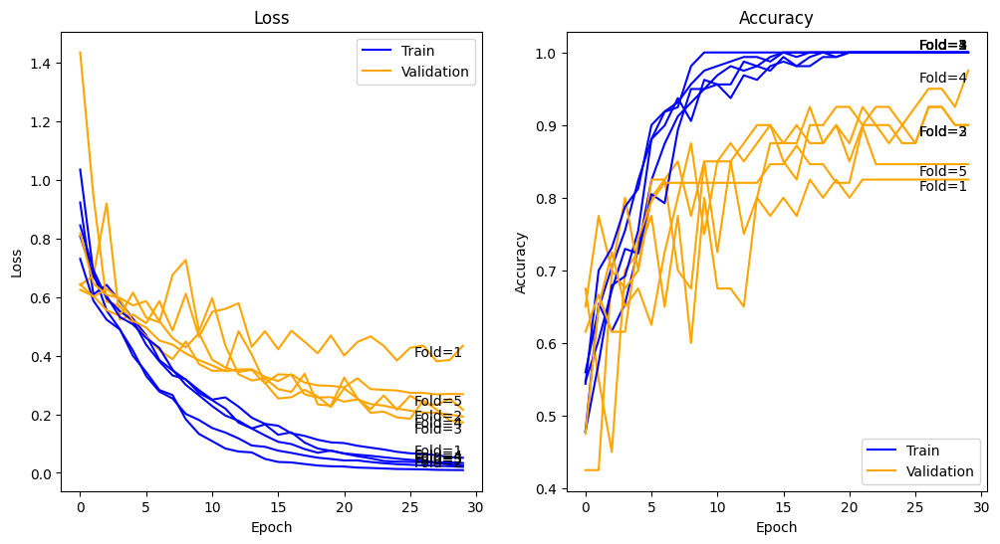

Accuracy: mean=88.923 std=5.210, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_fox,y_fox,n_folds,epochs,batch_size,define_model_elephant_simple)

## **Modele Fox avec les autre animaux**

Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_64 (Dense)            (None, 100)               11907300  
                                                                 
 dropout_52 (Dropout)        (None, 100)               0         
                                                                 
 dense_65 (Dense)            (None, 1)                 101       
                                                     

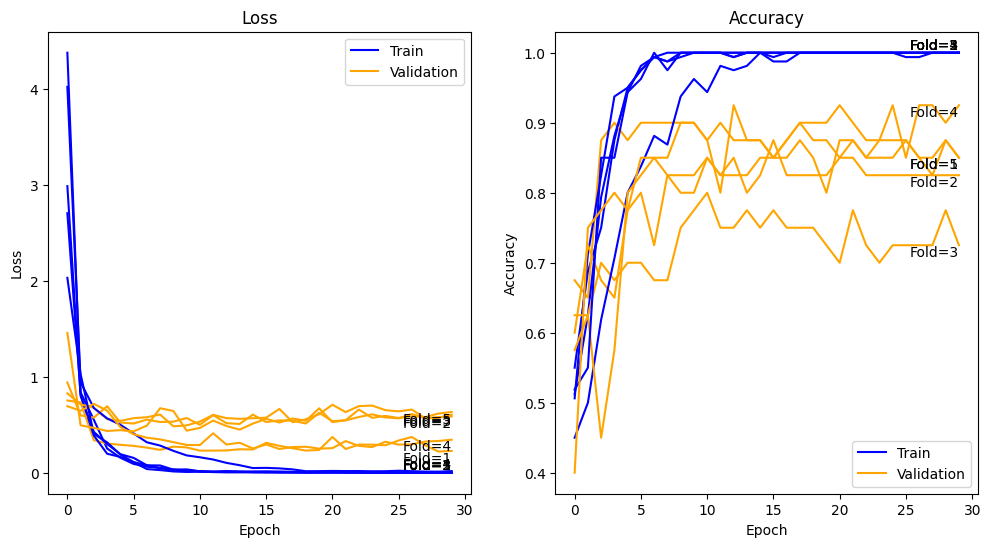

Accuracy: mean=83.500 std=6.442, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_tiger,y_tiger,n_folds,epochs,batch_size,define_model_fox)

### Elephant

Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_52 (Dense)            (None, 100)               11907300  
                                                                 
 dropout_46 (Dropout)        (None, 100)               0         
                                                                 
 dense_53 (Dense)            (None, 1)                 101       
                                                     

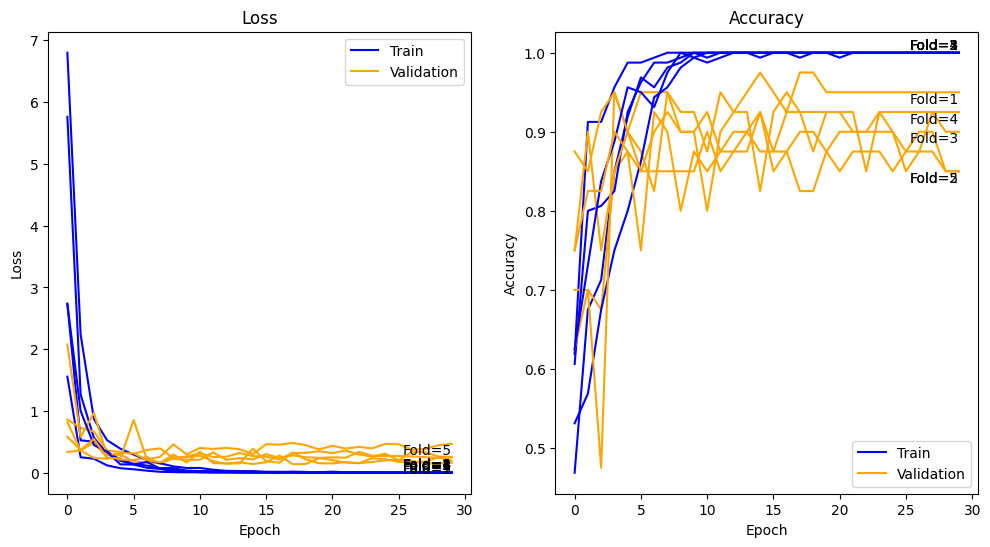

Accuracy: mean=89.500 std=4.000, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_elephant,y_elephant,n_folds,epochs,batch_size,define_model_fox)

### Tigre

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_2 (Dense)             (None, 100)               11907300  
                                                                 
 dropout_1 (Dropout)         (None, 100)               0         
                                                                 
 dense_3 (Dense)             (None, 1)                 101       
                                                      

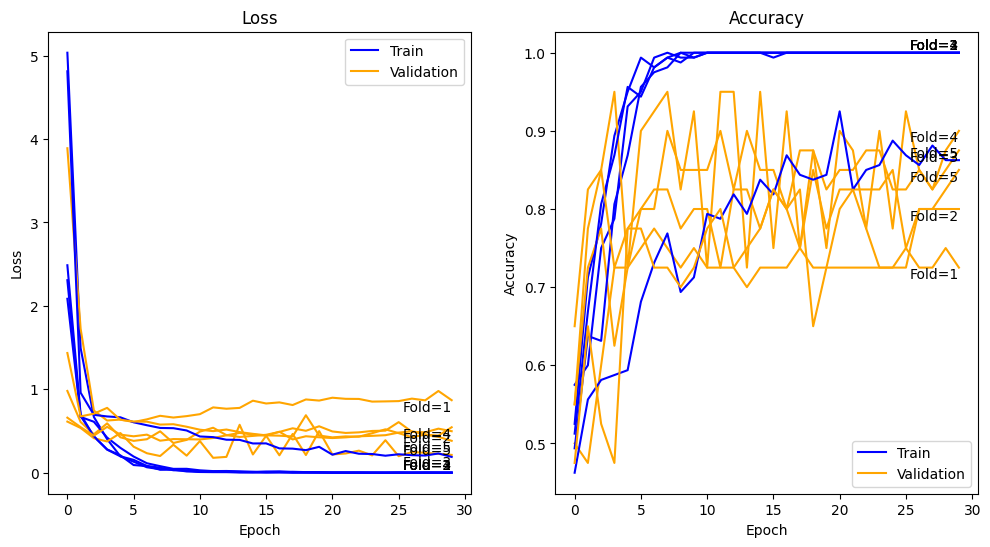

Accuracy: mean=83.000 std=6.205, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
run_evaluation(X_tiger,y_tiger,n_folds,epochs,batch_size,define_model_fox)

# **Données Augmentées**

En utilisant l'Image Data Generator, on a généré de nouvelles données et comparé les résultats de les classifieurs précédents, à savoir modeleBaseline, modeleTiger, modeleFox, modeleElephant, avec ceux obtenus à partir des nouvelles données.

## **Fonction d'entrainement et d'evaluation**

In [ ]:
def custom_train_generator(X_train, y_train, batch_size, total_images, datagen):
    while True:
        generator = datagen.flow(X_train, y_train, batch_size=batch_size)
        counter = 0

        while counter < total_images:
            X_batch, y_batch = next(generator)
            yield X_batch, y_batch
            counter += len(X_batch)

In [ ]:
def evaluate_augmented_model(modelf, dataX, dataY, n_folds=5, epochs=10, batch_size=32, total_train_images=1000):
    scores, histories = list(), list()
    kfold = KFold(n_folds, shuffle=True, random_state=1)

    for train_ix, test_ix in kfold.split(dataX):
        X_train, y_train, X_test, y_test = dataX[train_ix], dataY[train_ix], dataX[test_ix], dataY[test_ix]

        # Ré-initialisation du modèle
        model = modelf()

        # Configuration de l'Image Data Generator pour l'entraînement
        train_datagen = ImageDataGenerator(horizontal_flip=True,
                                           vertical_flip=False,
                                           rotation_range=10,
                                           width_shift_range=0.05,
                                           height_shift_range=0.05,
                                           fill_mode='wrap',
                                           zoom_range=[0.8,1.1])

        # Création du générateur personnalisé pour les données d'entraînement
        train_generator = custom_train_generator(X_train, y_train, batch_size, total_train_images, train_datagen)

        # Calcul du steps_per_epoch basé sur le nombre total d'images d'entraînement désiré
        steps_per_epoch = total_train_images // batch_size

        # Fit du modèle avec le générateur
        history = model.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch,
                            validation_data=(X_test, y_test), verbose=1)

        # Evaluate du modèle
        loss, acc = model.evaluate(X_test, y_test, verbose=0)
        print('accuracy %.3f' % (acc * 100.0))
        scores.append(acc)
        histories.append(history)

    return scores, histories

In [ ]:
# fonction pour charger, transformer et évaluer le modele
# elle lance n-folds fois l'évaluation et affiche les courbes et résultats
def run_augmented_evaluation(X,y,n_folds,epochs,batch_size=32,model=define_model,nbr_image=200,printk=True):
    # load dataset
    # X_train, y_train, X_test, y_test = load_my_dataset(X,y)
    # Nettoyage et normalisation
    # X_train,X_test = clean_data(X,X)
    # define model
    modelInst = model()
    print (modelInst.summary())
    # evaluate model
    scores, histories = evaluate_augmented_model(model, X, y, n_folds,epochs,batch_size,nbr_image)
    plot_curves(histories, printk)
    print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores)*100, std(scores)*100, len(scores)))

## **Tigre**

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_24 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_24 (Dense)            (None, 100)             

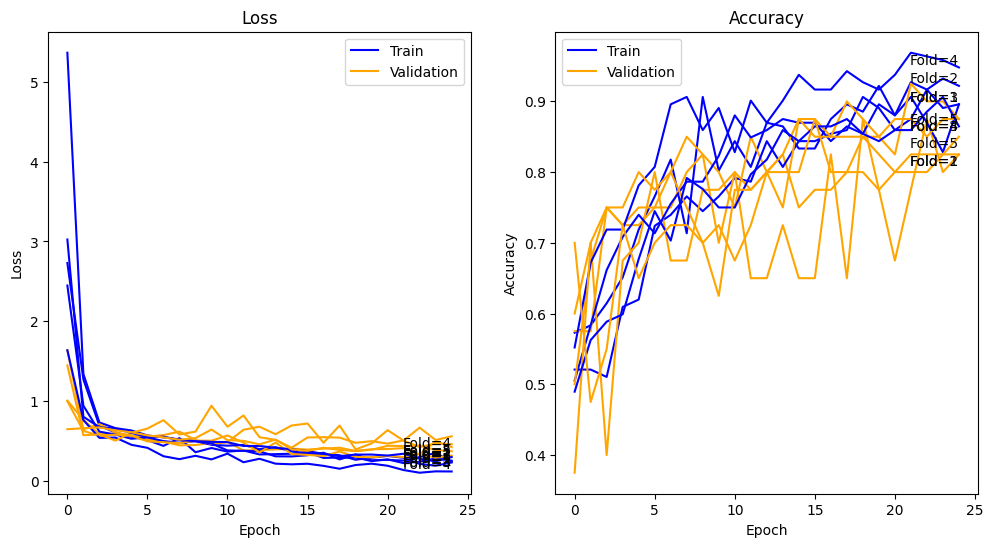

Accuracy: mean=85.000 std=2.236, n=5


In [ ]:
n_folds=5
epochs=25
batch_size=16
history=run_augmented_evaluation(Xd_tiger,yd_tiger,n_folds,epochs,batch_size,define_tiger_model,200)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 123, 123, 32)      416       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout (Dropout)           (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense (Dense)               (None, 100)               1

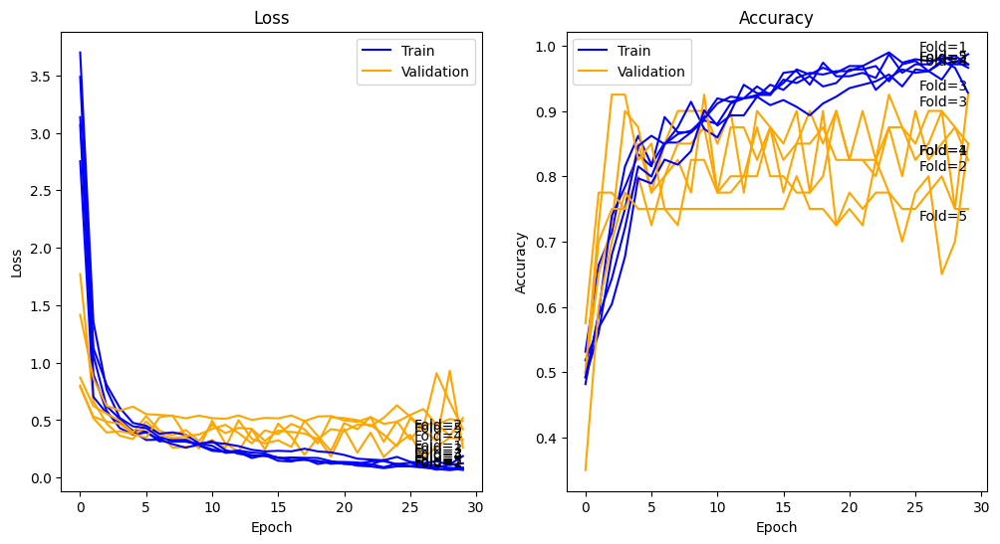

Accuracy: mean=84.000 std=5.612, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32
history=run_augmented_evaluation(X_tiger,y_tiger,n_folds,epochs,batch_size,define_tiger_model,400)

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_36 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_36 (Dense)            (None, 100)             

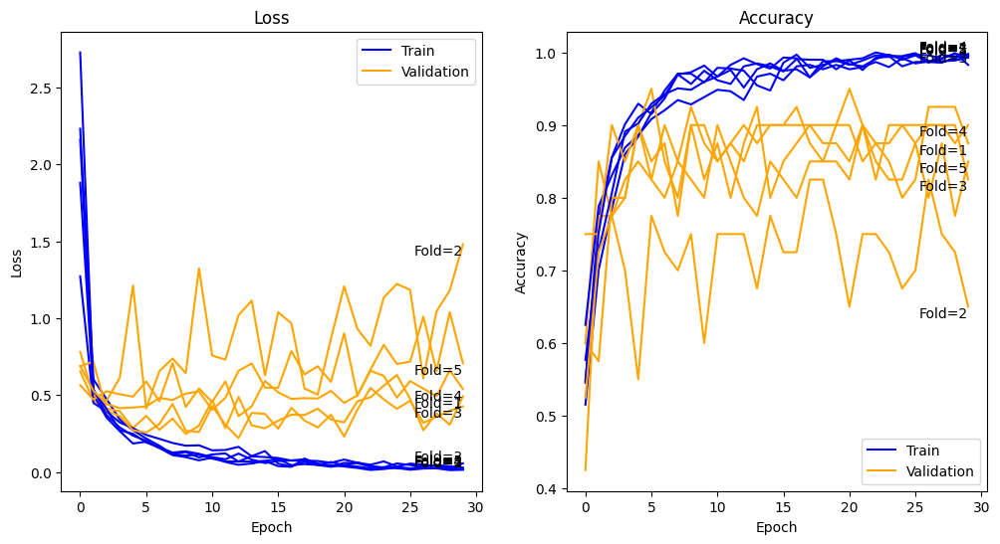

Accuracy: mean=82.000 std=8.860, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32
history=run_augmented_evaluation(Xd_tiger,yd_tiger,n_folds,epochs,batch_size,define_tiger_model,1000)

In [ ]:
def define_tiger_augmented_model():
     model = Sequential()
     # Convolution and pooling
     model.add(Conv2D(filters=32, kernel_size=(3, 3),
                      activation='relu', input_shape=(124, 124, 3),
                      name="Conv2D_1"))
     model.add(MaxPooling2D(pool_size=(2, 2),
                            name="Maxpooling2D_1"))

     model.add(Conv2D(filters=64, kernel_size=(3, 3),
                      activation='relu', input_shape=(124, 124, 3),
                      name="Conv2D_2"))
     model.add(MaxPooling2D(pool_size=(2, 2),
                            name="Maxpooling2D_2"))

 		# flatten
     model.add(Flatten(name="flatten") )

     # Partie classification
     model.add(Dense(128, activation='relu'))
     model.add(Dense(64, activation='relu'))
     model.add(Dense(1, activation='sigmoid'))

     # compile model
     opt = Adam(learning_rate=0.0001)
     model.compile(optimizer=opt, loss='binary_crossentropy',
                   metrics=['accuracy'])
     return model

Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 dropout_48 (Dropout)        (None, 122, 122, 32)      0         
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Conv2D_2 (Conv2D)           (None, 59, 59, 64)        18496     
                                                                 
 dropout_49 (Dropout)        (None, 59, 59, 64)        0         
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 29, 29, 64)        0         
 2D)                                                 

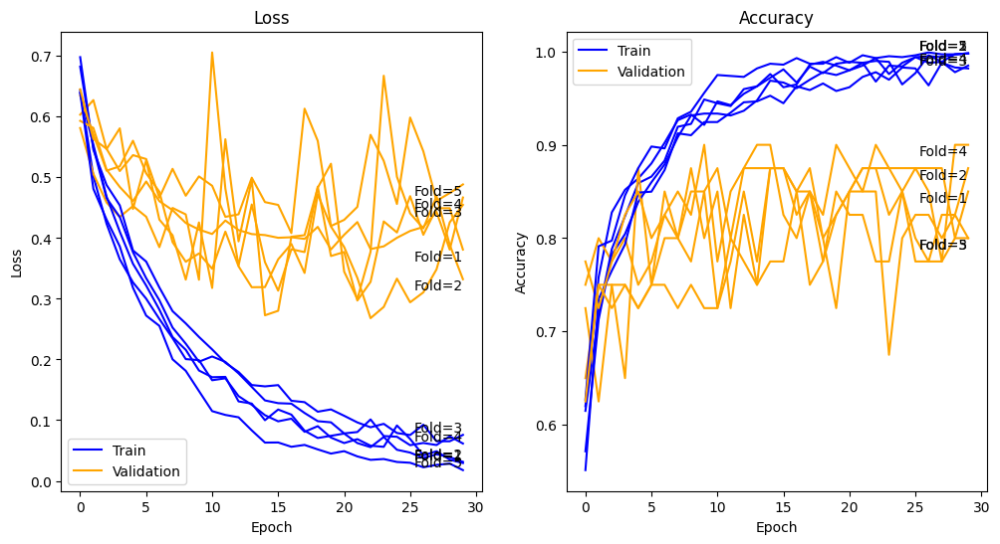

Accuracy: mean=84.500 std=4.000, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32
history=run_augmented_evaluation(Xd_tiger,yd_tiger,n_folds,epochs,batch_size,define_tiger_augmented_model,1000)

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_8 (Dropout)         (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_8 (Dense)             (None, 100)              

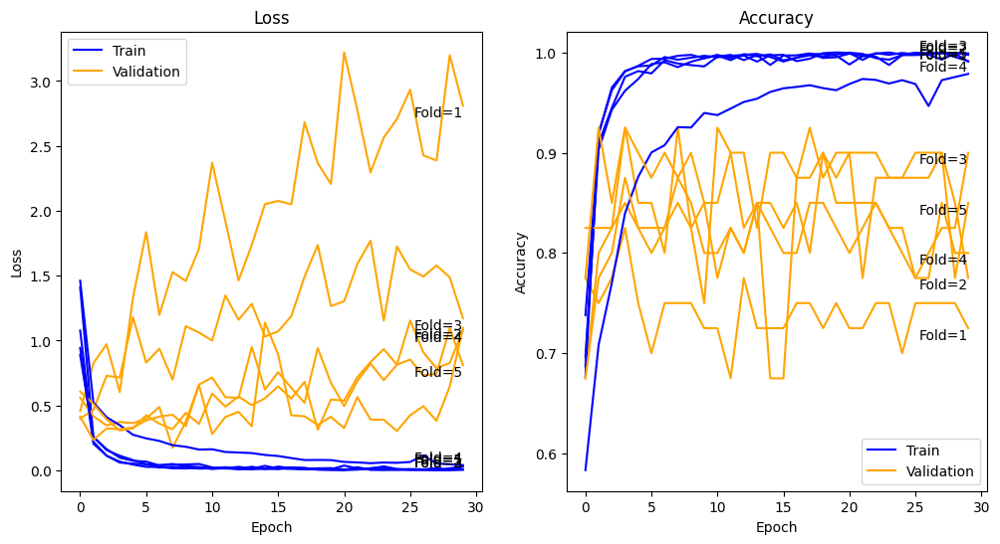

Accuracy: mean=81.000 std=6.042, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=64
history=run_augmented_evaluation(Xd_tiger,yd_tiger,n_folds,epochs,batch_size,define_tiger_model,5000)

Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Conv2D_2 (Conv2D)           (None, 59, 59, 64)        18496     
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 29, 29, 64)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 53824)             0         
                                                                 
 dense_204 (Dense)           (None, 128)            

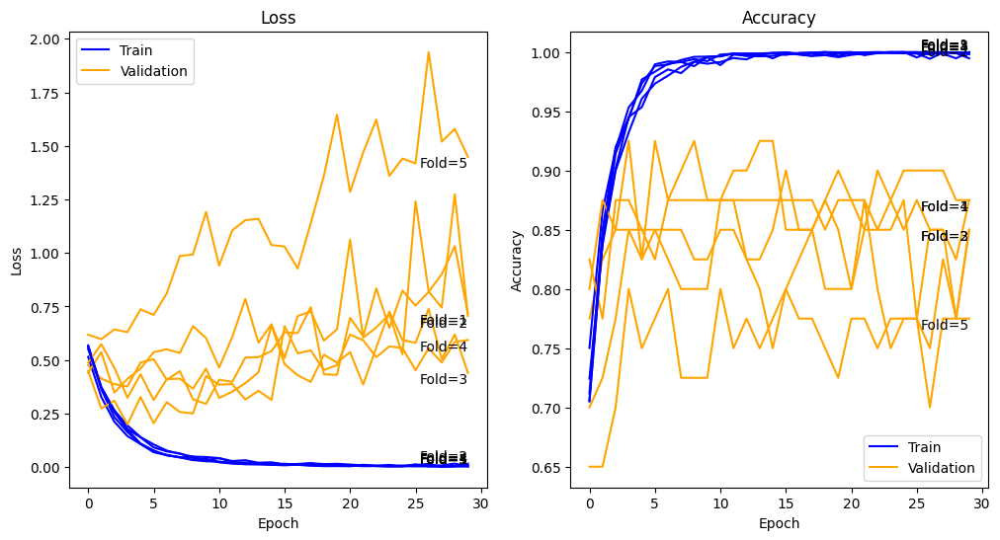

Accuracy: mean=84.500 std=3.674, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=64
history=run_augmented_evaluation(Xd_tiger,yd_tiger,n_folds,epochs,batch_size,define_tiger_augmented_model,5000)

In [ ]:
def custom_train_generator(X_train, y_train, batch_size, total_images, datagen, original_dataX, original_dataY):
    while True:
        generator = datagen.flow(X_train, y_train, batch_size=int(batch_size / 2))
        original_batches = np.ceil(len(original_dataX) / (batch_size / 2))
        repeat_factor = np.ceil(total_images / (batch_size * original_batches))
        original_dataX_repeated = np.tile(original_dataX, (int(repeat_factor), 1, 1, 1))
        original_dataY_repeated = np.tile(original_dataY, int(repeat_factor))

        original_data_generator = zip(np.array_split(original_dataX_repeated, total_images // batch_size),
                                      np.array_split(original_dataY_repeated, total_images // batch_size))

        counter = 0

        while counter < total_images:
            X_batch_aug, y_batch_aug = next(generator)
            X_batch_orig, y_batch_orig = next(original_data_generator)
            X_batch = np.concatenate((X_batch_aug, X_batch_orig), axis=0)
            y_batch = np.concatenate((y_batch_aug, y_batch_orig), axis=0)

            yield X_batch, y_batch
            counter += len(X_batch)

def evaluate_augmented_model(modelf, dataX, dataY, n_folds, epochs, batch_size, total_train_images):
    scores, histories = list(), list()
    kfold = KFold(n_folds, shuffle=True, random_state=1)

    for train_ix, test_ix in kfold.split(dataX):
        X_train, y_train, X_test, y_test = dataX[train_ix], dataY[train_ix], dataX[test_ix], dataY[test_ix]
        model = modelf()
        train_datagen = ImageDataGenerator(horizontal_flip=True, vertical_flip=False, rotation_range=10, width_shift_range=0.05, height_shift_range=0.05, fill_mode='wrap', zoom_range=[0.8,1.1])
        train_generator = custom_train_generator(X_train, y_train, batch_size, total_train_images, train_datagen, dataX, dataY)
        steps_per_epoch = total_train_images // batch_size
        history = model.fit(train_generator, epochs=epochs, steps_per_epoch=steps_per_epoch, validation_data=(X_test, y_test), verbose=1)
        loss, acc = model.evaluate(X_test, y_test, verbose=0)
        print('Accuracy: %.3f' % (acc * 100.0))
        scores.append(acc)
        histories.append(history)

    return scores, histories

## **Elephant**

Pour les éléphants, nous avons tenté plusieurs approches dans la manière dont les données augmentés sont utilisé par notre modèle :

1.   Augmentation avant les folds
2.   Augmentation à chaque fold
3.   Sans les k-folds



### *Fonctions spécifique*

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt

def augment_data(x, y, n_samples=200, batch_size=1):

    # Configuration plus détaillée pour l'augmentation des données
    datagen = ImageDataGenerator(
        rotation_range=15,    # Rotation jusqu'à 15 degrés
        width_shift_range=0.05, # Décalage horizontal jusqu'à 5% de la largeur de l'image
        height_shift_range=0.05, # Décalage vertical jusqu'à 5% de la hauteur de l'image
        zoom_range=[0.8, 1.1],        # Zoom jusqu'à 20%
        horizontal_flip=True,  # Renversement horizontal
        fill_mode='wrap'    # Stratégie pour remplir les nouveaux pixels qui peuvent apparaître après la transformation
    )

    xt, yt = [], []
    total_batches = n_samples // batch_size

    # Génération des nouvelles données
    for i, (X_batch, y_batch) in enumerate(datagen.flow(x, y, batch_size=batch_size, shuffle=True)):

      xt.append(X_batch)
      yt.append(y_batch)

      # Arrêter une fois le nombre d'échantillons requis atteint
      if i >= total_batches - 1:
          break

    # Concaténation des échantillons générés
    xt = np.concatenate(xt, axis=0)
    yt = np.concatenate(yt, axis=0)

    return xt, yt

(25, 124, 124, 3) (25,)


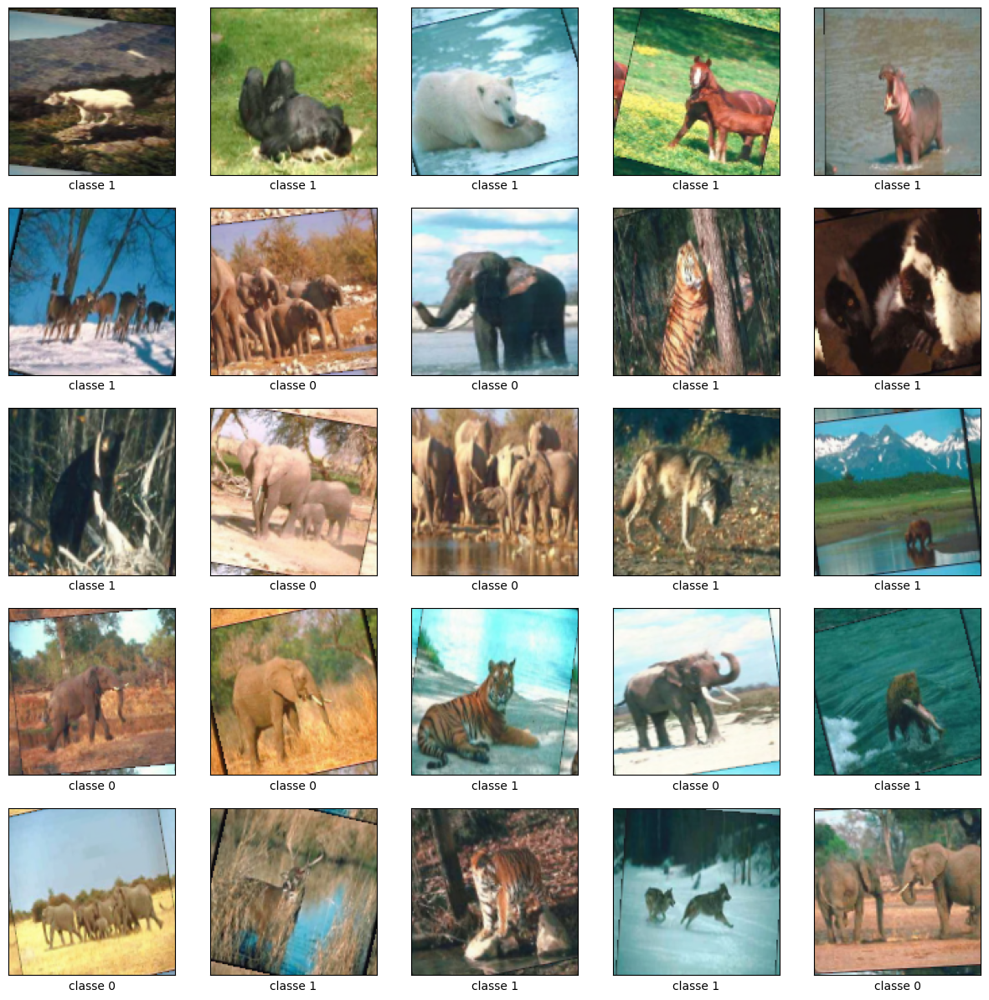

In [ ]:
Xt,yt = augment_data(X_elephant, y_elephant, n_samples=25)
print(Xt.shape, yt.shape)

plot_examples(Xt, yt)

In [ ]:
def evaluate_model_augmented(dataX, dataY, n_folds=5, epochs=10, batch_size=32, n_samples=200, modelID=0):
    scores, histories = list(), list()
    kfold = KFold(n_folds, shuffle=True, random_state=1)

    # parcourir les splits du k-fold
    for train_ix, test_ix in kfold.split(dataX):

      X_train, y_train, X_test, y_test = dataX[train_ix], dataY[train_ix], dataX[test_ix], dataY[test_ix]

      # Des données augmenté différentes pour chaques trains
      X_augmented, y_augmented = augment_data(X_train, y_train, n_samples=n_samples)

      # ré-initialisation du modèle
      if modelID == 0:
        model = define_baseline()
      elif modelID == 1:
        model = define_model_elephant()
      elif modelID == 2:
        model = modeleIDGElephant()
      elif modelID == 3:
        model = modeleIDGElephant_simple()

      # fit du modele
      history = model.fit(X_augmented, y_augmented, epochs=epochs, batch_size=batch_size,
                          validation_data=(X_test, y_test), verbose=1) # callback pour IDGE : , callbacks=[early_stopping]

      # evaluate du modele
      loss, acc = model.evaluate(X_test, y_test, verbose=0)
      print('accuracy %.3f' % (acc * 100.0))
      scores.append(acc)
      histories.append(history)

    return scores, histories

In [ ]:
def run_evaluation_augmented(X_train,y_train,n_folds,epochs,batch_size=32, n_samples=200, modelID=0,printk=True):

	# define model
	if modelID == 0:
		model = define_baseline()
	elif modelID == 1:
		model = define_model_elephant()
	elif modelID == 2:
		model = modeleIDGElephant()
	elif modelID == 3:
		model = modeleIDGElephant_simple()

	print(model.summary())

	# evaluate model
	scores, histories = evaluate_model_augmented(X_train, y_train, n_folds,epochs, batch_size, n_samples, modelID)
	plot_curves(histories, printk, limit=False)
	print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores)*100, std(scores)*100, len(scores)))

### *1. Data augmentation avant k-fold*

In [ ]:
X_plus,y_plus = augment_data(X_elephant, y_elephant, n_samples=1000)

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_18 (Dense)            (None, 100)               11907300  
                                                                 
 dense_19 (Dense)            (None, 1)                 101       
                                                      

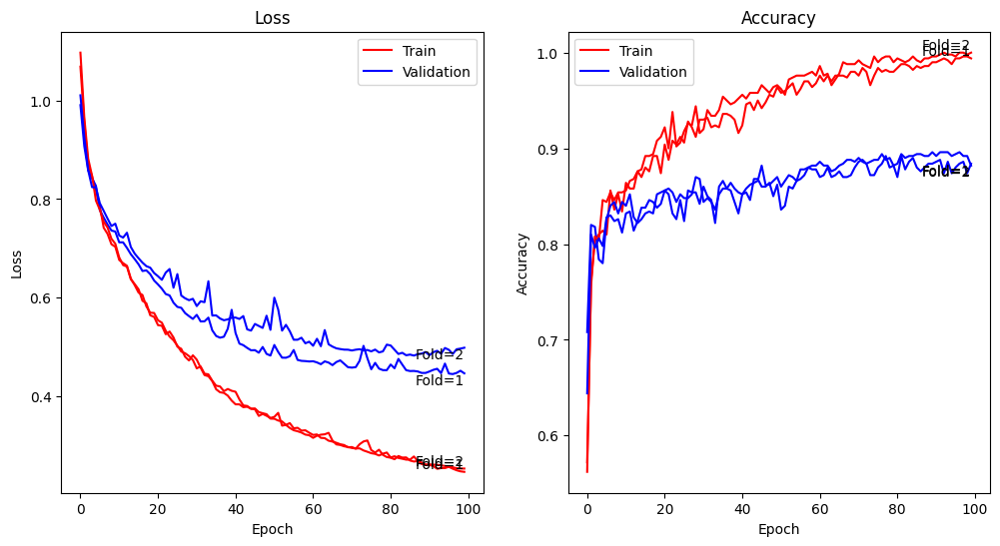

Accuracy: mean=88.300 std=0.100, n=2


In [ ]:
# Entraînement du modèle

COLUMNS = 1
n_folds=2
epochs=100
batch_size=32
run_evaluation(X_plus, y_plus, n_folds, epochs, batch_size, modelID=1)

### *2. Data augmentation à chaque k-folds*

In [ ]:
print(X_elephant.shape)
print(y_elephant.shape)

(200, 124, 124, 3)
(200,)


Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_12 (Dense)            (None, 100)               11907300  
                                                                 
 dense_13 (Dense)            (None, 1)                 101       
                                                      

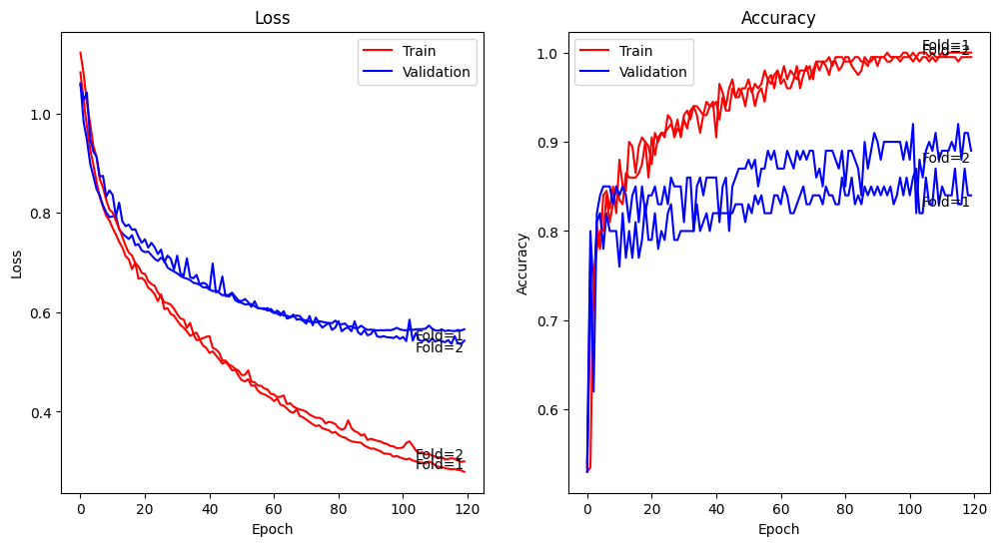

Accuracy: mean=86.500 std=2.500, n=2


In [ ]:
# Entraînement du modèle

COLUMNS = 1
n_folds=2
epochs=120
batch_size=32
run_evaluation_augmented(X_elephant, y_elephant, n_folds,epochs,batch_size,n_samples=200,modelID=1)

In [ ]:
def define_model_elephant_IDG():
    model = Sequential()

    # Convolution and pooling
    model.add(Conv2D(filters=32, kernel_size=(3, 3),
                     activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3), # 3 car couleurs
                     name="Conv2D_1"))

    model.add(MaxPooling2D(pool_size=(2, 2),
                           name="Maxpooling2D_1"))

    model.add(MaxPooling2D(pool_size=(1, 1),
                            name="Maxpooling2D_2"))

    model.add(Dropout(0.2))
		# flatten
    model.add(Flatten(name="flatten") )

    # Partie classification
    model.add(Dense(125, activation='relu'))
    model.add(Dense(1, activation='sigmoid')) # 1 car vrai/faux

    # compile model
    adam = Adam(learning_rate=0.001)
    model.compile(optimizer=adam, loss='binary_crossentropy',
                  metrics=['accuracy'])

    return model

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 Maxpooling2D_2 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_33 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_86 (Dense)            (None, 125)             

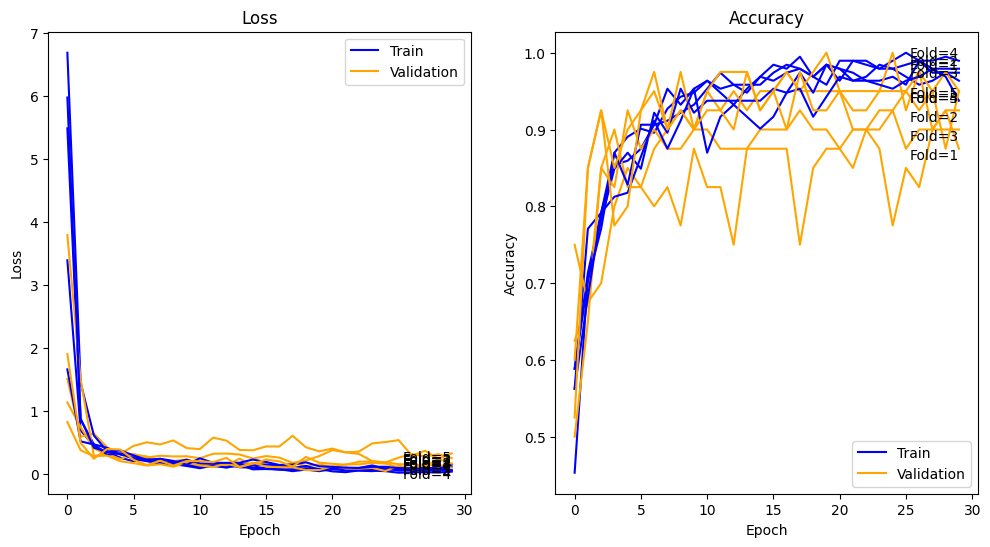

Accuracy: mean=92.000 std=2.915, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=16
history=run_augmented_evaluation(X_elephant,y_elephant,n_folds,epochs,batch_size,define_model_elephant_IDG,200)

### 3. *Data augmentation sans k-fold*

In [ ]:
X_train, y_train, X_test, y_test = load_my_dataset(X_elephant, y_elephant)
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(160, 124, 124, 3)
(160,)
(40, 124, 124, 3)
(40,)


Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 61, 61, 32)        0         
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_24 (Dense)            (None, 100)               11907300  
                                                                 
 dense_25 (Dense)            (None, 1)                 101       
                                                     

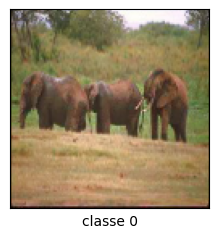

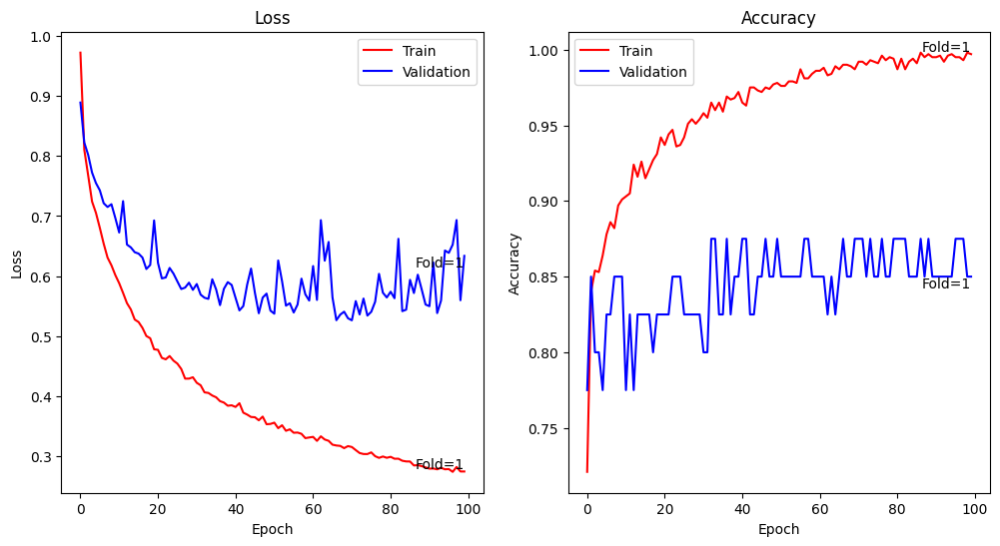

Accuracy: mean=85.000 std=0.000, n=1


In [ ]:
epochs=100
batch_size = 32

# definition du modèle
# on utilise le même que précédemment
model = define_model_elephant()
print (model.summary())

# mis en place du générateur avec décalage de 0.2 en largeur, 0.2 en hauteur et
# permutation horizontale
datagen = ImageDataGenerator(width_shift_range=0.2,
                               height_shift_range=0.2,
                                horizontal_flip=True)

# preparation de l'iterateur pour remplir les batchs.

# batches = datagen.flow(X_train, y_train, batch_size=batch_size)
# print(X_train.shape)

Xt,yt = augment_data(X_train, y_train, n_samples=1000)

# appel de la fonction fit. Dans les anciennes versions de Keras
# mettre fit_generator
# history = model.fit(batches,
#                     #steps_per_epoch=X_train.shape[0] // batch_size,
#                     epochs=epochs,
#                     validation_data=(X_test, y_test), verbose=1)

history = model.fit(Xt, yt,
                    #steps_per_epoch=X_train.shape[0] // batch_size,
                    epochs=epochs,
                    batch_size=batch_size,
                    validation_data=(X_test, y_test), verbose=1)

plot_examples(X_test, y_test)

# EVALUATION
scores = list()
histories = list()

# evaluate du modele
loss, acc = model.evaluate(X_test, y_test, verbose=0)
print('accuracy %.3f' % (acc * 100.0))
scores.append(acc)
histories.append(history)

plot_curves(histories, limit=False)
print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores)*100, std(scores)*100, len(scores)))

## **Renard**

In [ ]:
from sklearn.model_selection import KFold

def evaluate_model_augmented_fox(modelf, dataX, dataY, n_folds=5, epochs=10, batch_size=32):
    scores, histories = list(), list()
    kfold = KFold(n_folds, shuffle=True, random_state=1)

    # parcourir les splits du k-fold

    for train_ix, test_ix in kfold.split(dataX):

        # selection des données
        X_train, y_train, X_test, y_test = dataX[train_ix], dataY[train_ix], dataX[test_ix], dataY[test_ix]

        datagen = ImageDataGenerator(rotation_range=0.2, horizontal_flip=True, vertical_flip=True)

        batches = datagen.flow(X_train, y_train, batch_size=batch_size)

        # ré-initialisation du modèle
        model = modelf()

        # fit du modele
        history = model.fit(batches, epochs=epochs, batch_size=batch_size,
                            validation_data=(X_test, y_test), verbose=1)

        # evaluate du modele
        loss, acc = model.evaluate(X_test, y_test, verbose=0)
        print('accuracy %.3f' % (acc * 100.0))
        scores.append(acc)
        histories.append(history)

    return scores, histories

In [ ]:
def run_evaluation(model,X,y,n_folds,epochs,batch_size=32,printk=True):
	# load dataset
	# Nettoyage et normalisation
	# X_train, X_test = clean_data(X, X)
	print(X.shape)
	modelInst = model()
	print (modelInst.summary())
	# evaluate model
	scores, histories = evaluate_model_augmented_fox(model, X, y, n_folds,epochs,batch_size)
	plot_curves(histories, printk)
	print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores)*100, std(scores)*100, len(scores)))

(200, 124, 124, 3)
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Conv2D_1 (Conv2D)           (None, 122, 122, 32)      896       
                                                                 
 Maxpooling2D_1 (MaxPooling  (None, 61, 61, 32)        0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 119072)            0         
                                                                 
 dense_4 (Dense)             (None, 100)               11907300  
                                                                 
 dropout_2 (Dropout)         (None, 100)               0         
                                                                 
 dense_5 (Dense)             (None, 1)                 101       
                                   

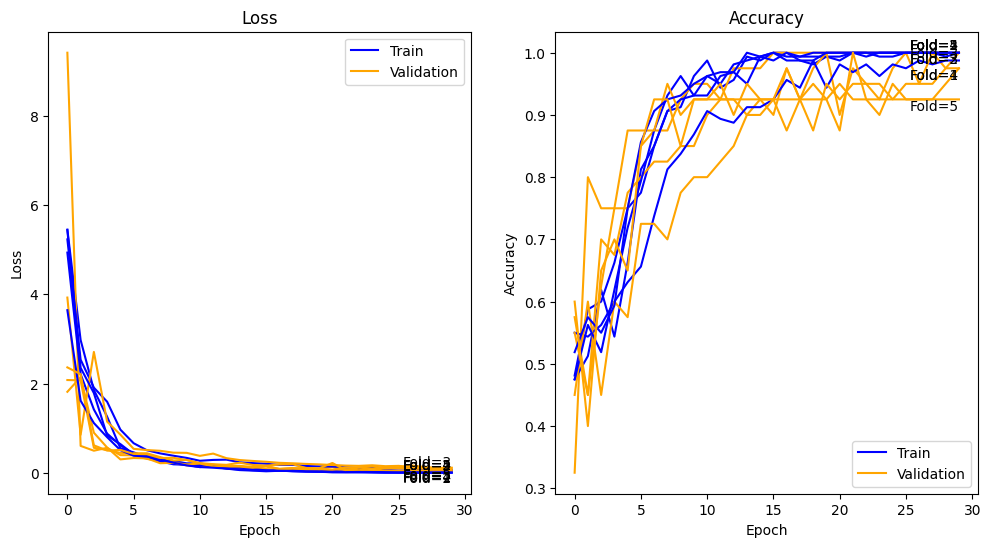

Accuracy: mean=97.500 std=2.739, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32
run_evaluation(define_model_fox,X_fox,y_fox,n_folds,epochs, batch_size)

# **Transfer Learning**

In [ ]:
def create_exception_model():
    base_model = keras.applications.Xception(
        weights="imagenet",
        input_shape=(124, 124, 3),
        include_top=False,
    )

    # Freeze the base_model
    base_model.trainable = False

    # Creating new model on top
    inputs = keras.Input(shape=(124, 124, 3))
    x = base_model(inputs, training=False)
    x = keras.layers.GlobalAveragePooling2D()(x)
    x = keras.layers.Dropout(0.2)(x)  # Regularize with dropout
    outputs = keras.layers.Dense(1, activation='sigmoid')(x)
    model = keras.Model(inputs, outputs)
    model.compile(optimizer='Adam', loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

    # model.summary(show_trainable=True)
    return model, base_model

In [ ]:
def evaluate_model_finetuning(modelf, dataX, dataY, n_folds=5, epochs=10, batch_size=32):
    scores, histories = list(), list()
    scores2, histories2 = list(), list()
    kfold = KFold(n_folds, shuffle=True, random_state=1)

    # parcourir les splits du k-fold

    for train_ix, test_ix in kfold.split(dataX):

        # selection des données
        X_train, y_train, X_test, y_test = dataX[train_ix], dataY[train_ix], dataX[test_ix], dataY[test_ix]

        # X_train_augmented, y_train_augmented = augment_data(X_train, y_train, n_samples=1000)

        # X_train_combined = np.concatenate([X_train, X_train_augmented], axis=0)
        # y_train_combined = np.concatenate([y_train, y_train_augmented], axis=0)

        # X_train_combined, X_test = clean_data(X_train_combined, X_test)

        # datagen = ImageDataGenerator(width_shift_range=0.2,
        #                               height_shift_range=0.2,
        #                                 horizontal_flip=True)

        datagen = ImageDataGenerator(rotation_range=0.2, horizontal_flip=True, vertical_flip=True)


        # preparation de l'iterateur pour remplir les batchs.
        batches = datagen.flow(X_train, y_train, batch_size=batch_size)

        # ré-initialisation du modèle
        model, base_model = modelf()

        # fit du modele
        history = model.fit(batches, epochs=epochs, batch_size=batch_size,
                            validation_data=(X_test, y_test), verbose=1)

        # evaluate du modele
        loss, acc = model.evaluate(X_test, y_test, verbose=0)
        print('accuracy %.3f' % (acc * 100.0))
        scores.append(acc)
        histories.append(history)

        base_model.trainable = True
        model.summary(show_trainable=True)

        model.compile(optimizer=keras.optimizers.Adam(1e-5), loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

        print("Fitting the end-to-end model")
        history2 = model.fit(batches, epochs=10,
                            validation_data=(X_test, y_test), verbose=1)

        # evaluate du modele
        loss2, acc2 = model.evaluate(X_test, y_test, verbose=0)
        print('accuracy %.3f' % (acc2 * 100.0))
        scores2.append(acc2)
        histories2.append(history2)

    return scores, histories, scores2, histories2

In [ ]:
def run_evaluation_finetuning(model,X,y,n_folds,epochs,batch_size=32,printk=True):
	# load dataset
	# Nettoyage et normalisation
	# X_train, X_test = clean_data(X, X)
	print(X.shape)
	modelInst, base_model = model()
	print (modelInst.summary(show_trainable=True))
	# evaluate model
	scores, histories, scores2, histories2 = evaluate_model_finetuning(model, X, y, n_folds,epochs,batch_size)
	plot_curves(histories, printk)
	print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores)*100, std(scores)*100, len(scores)))
	plot_curves(histories2, printk)
	print('Accuracy: mean=%.3f std=%.3f, n=%d' % (mean(scores2)*100, std(scores2)*100, len(scores2)))

(200, 124, 124, 3)
Model: "model_2"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_6 (InputLayer)        [(None, 124, 124, 3)]     0         Y          
                                                                            
 xception (Functional)       (None, 4, 4, 2048)        2086148   N          
                                                       0                    
                                                                            
 global_average_pooling2d_2  (None, 2048)              0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_22 (Dropout)        (None, 2048)              0         Y          
                                                                            
 dense_42 (Dense)            (None, 1)  

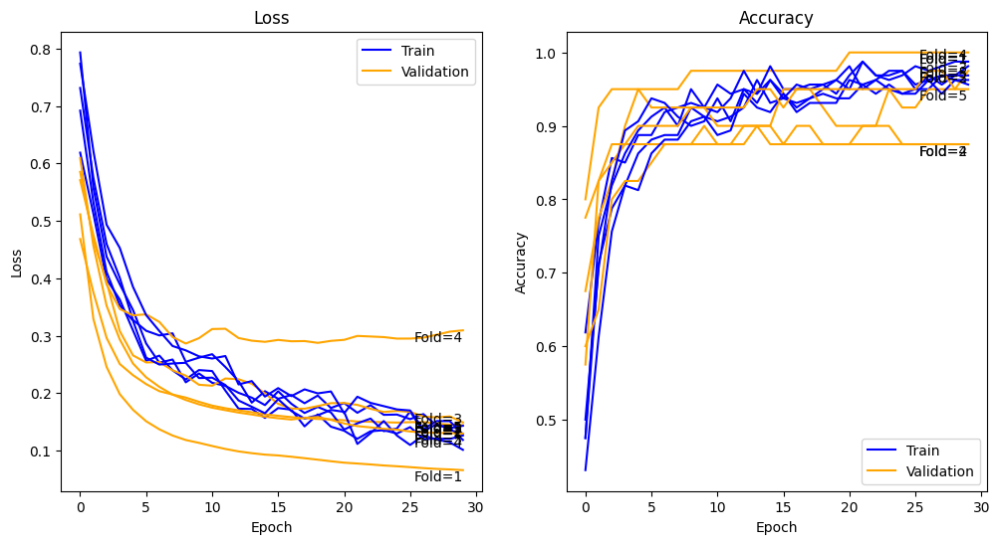

Accuracy: mean=93.500 std=5.148, n=5


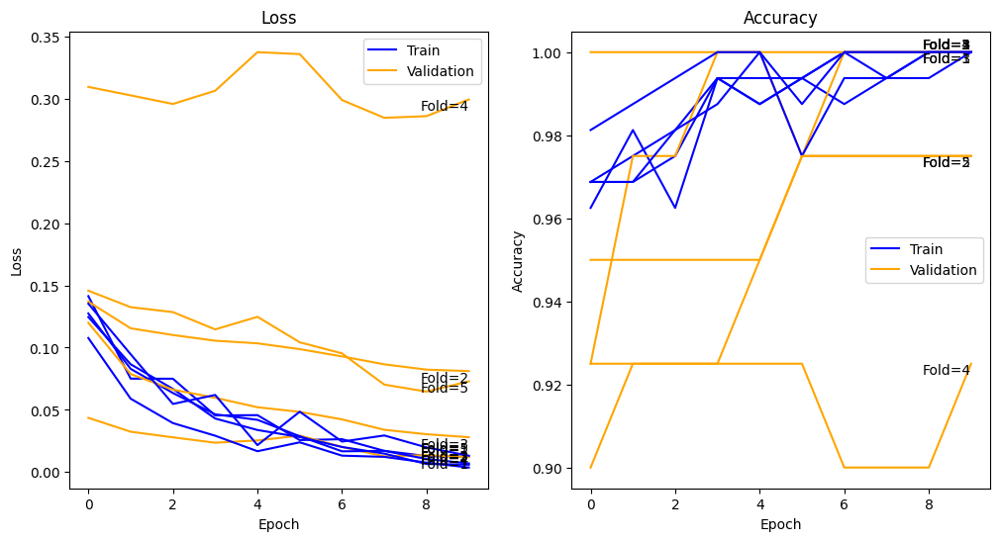

Accuracy: mean=97.500 std=2.739, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32

history=run_evaluation_finetuning(create_exception_model, X_tiger, y_tiger,n_folds,epochs,batch_size)

(200, 124, 124, 3)
Model: "model_8"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_18 (InputLayer)       [(None, 124, 124, 3)]     0         Y          
                                                                            
 xception (Functional)       (None, 4, 4, 2048)        2086148   N          
                                                       0                    
                                                                            
 global_average_pooling2d_8  (None, 2048)              0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_8 (Dropout)         (None, 2048)              0         Y          
                                                                            
 dense_8 (Dense)             (None, 1)  

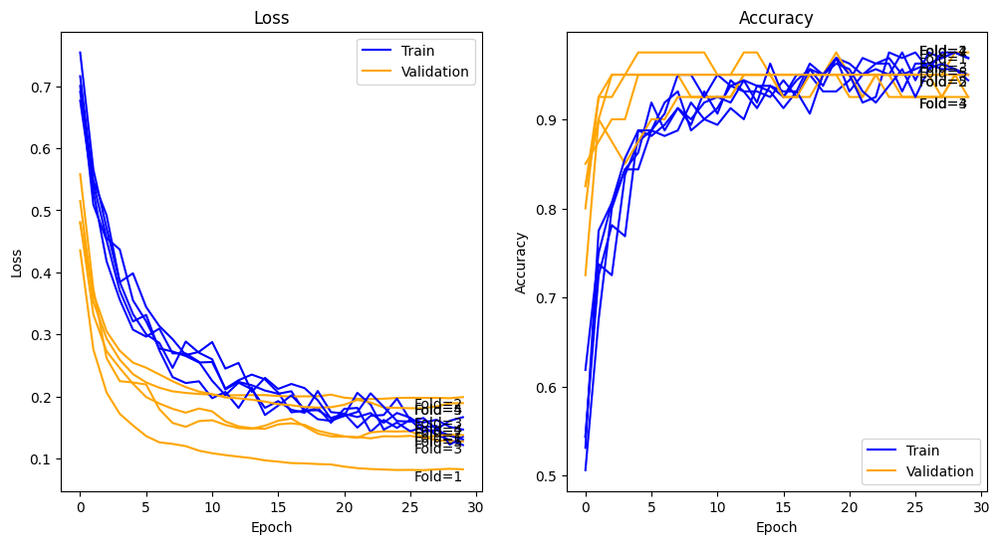

Accuracy: mean=94.500 std=1.871, n=5


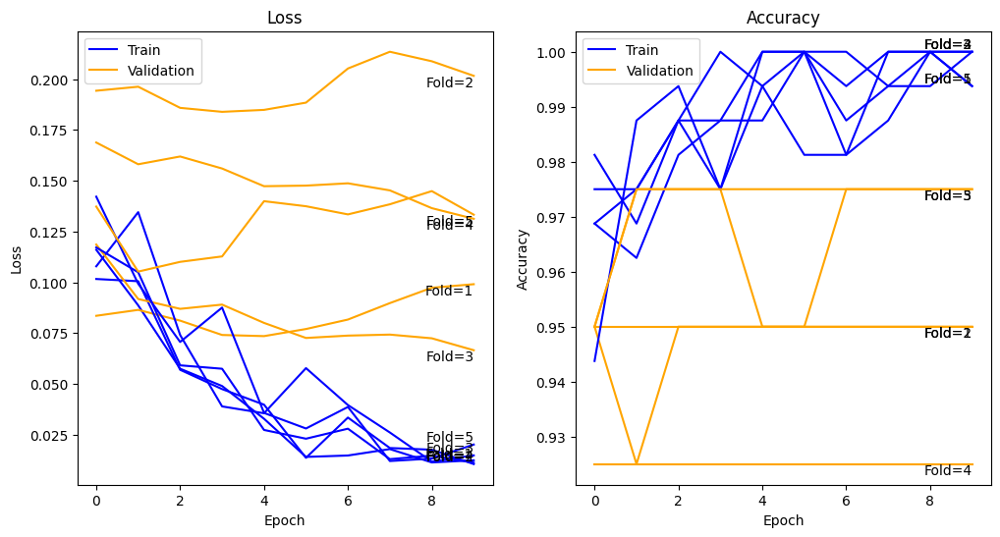

Accuracy: mean=95.500 std=1.871, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32

history=run_evaluation_finetuning(create_exception_model, X_elephant, y_elephant,n_folds,epochs,batch_size)

### **Renard**

(200, 124, 124, 3)
Model: "model_2"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_6 (InputLayer)        [(None, 124, 124, 3)]     0         Y          
                                                                            
 xception (Functional)       (None, 4, 4, 2048)        2086148   N          
                                                       0                    
                                                                            
 global_average_pooling2d_2  (None, 2048)              0         Y          
  (GlobalAveragePooling2D)                                                  
                                                                            
 dropout_2 (Dropout)         (None, 2048)              0         Y          
                                                                            
 dense_2 (Dense)             (None, 1)  

2023-12-14 03:06:54.514330: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8906
2023-12-14 03:06:58.948469: W tensorflow/tsl/framework/bfc_allocator.cc:366] Garbage collection: deallocate free memory regions (i.e., allocations) so that we can re-allocate a larger region to avoid OOM due to memory fragmentation. If you see this message frequently, you are running near the threshold of the available device memory and re-allocation may incur great performance overhead. You may try smaller batch sizes to observe the performance impact. Set TF_ENABLE_GPU_GARBAGE_COLLECTION=false if you'd like to disable this feature.
2023-12-14 03:07:01.754777: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7da21c009650 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-12-14 03:07:01.754821: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
2023-12-1

1/5 [=====>........................] - ETA: 58s - loss: 0.7516 - accuracy: 0.5938

2023-12-14 03:07:01.992520: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


5/5 [==============================] - 18s 792ms/step - loss: 0.8037 - accuracy: 0.5125 - val_loss: 0.8159 - val_accuracy: 0.4750
Epoch 2/30
5/5 [==============================] - 1s 245ms/step - loss: 0.7206 - accuracy: 0.5562 - val_loss: 0.7561 - val_accuracy: 0.5500
Epoch 3/30
5/5 [==============================] - 1s 228ms/step - loss: 0.6155 - accuracy: 0.6687 - val_loss: 0.5803 - val_accuracy: 0.7000
Epoch 4/30
5/5 [==============================] - 1s 153ms/step - loss: 0.5683 - accuracy: 0.7125 - val_loss: 0.5192 - val_accuracy: 0.8000
Epoch 5/30
5/5 [==============================] - 1s 143ms/step - loss: 0.4797 - accuracy: 0.7812 - val_loss: 0.4679 - val_accuracy: 0.8250
Epoch 6/30
5/5 [==============================] - 1s 142ms/step - loss: 0.4160 - accuracy: 0.8562 - val_loss: 0.4337 - val_accuracy: 0.8250
Epoch 7/30
5/5 [==============================] - 1s 144ms/step - loss: 0.3987 - accuracy: 0.8687 - val_loss: 0.4046 - val_accuracy: 0.8500
Epoch 8/30
5/5 [==============

2023-12-14 03:07:45.240604: W tensorflow/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 6.92GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.


5/5 [==============================] - 27s 390ms/step - loss: 0.1460 - accuracy: 0.9750 - val_loss: 0.2265 - val_accuracy: 0.9000
Epoch 2/10
5/5 [==============================] - 1s 191ms/step - loss: 0.0864 - accuracy: 0.9937 - val_loss: 0.2024 - val_accuracy: 0.9000
Epoch 3/10
5/5 [==============================] - 1s 194ms/step - loss: 0.0615 - accuracy: 0.9937 - val_loss: 0.1771 - val_accuracy: 0.9250
Epoch 4/10
5/5 [==============================] - 1s 194ms/step - loss: 0.0381 - accuracy: 1.0000 - val_loss: 0.1628 - val_accuracy: 0.9250
Epoch 5/10
5/5 [==============================] - 1s 273ms/step - loss: 0.0302 - accuracy: 0.9937 - val_loss: 0.1492 - val_accuracy: 0.9750
Epoch 6/10
5/5 [==============================] - 2s 295ms/step - loss: 0.0109 - accuracy: 1.0000 - val_loss: 0.1402 - val_accuracy: 0.9750
Epoch 7/10
5/5 [==============================] - 1s 198ms/step - loss: 0.0126 - accuracy: 1.0000 - val_loss: 0.1394 - val_accuracy: 0.9500
Epoch 8/10
5/5 [==============

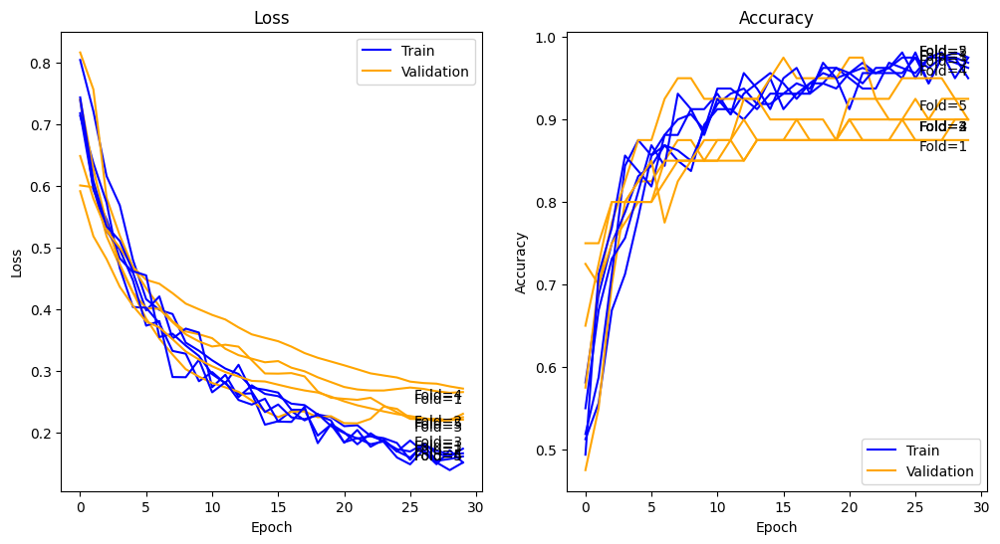

Accuracy: mean=90.000 std=1.581, n=5


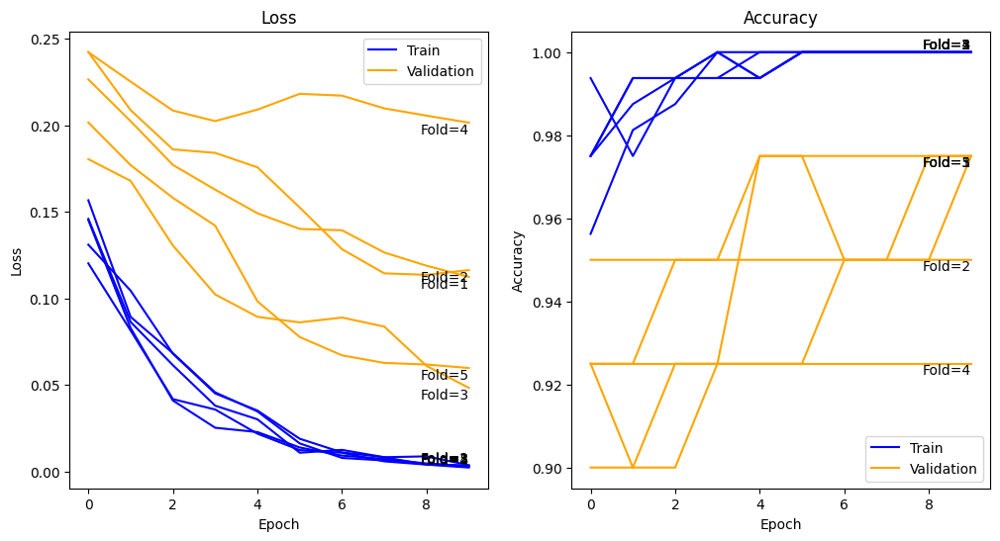

Accuracy: mean=96.000 std=2.000, n=5


In [ ]:
n_folds=5
epochs=30
batch_size=32

history=run_evaluation_finetuning(create_exception_model, X_fox, y_fox,n_folds,epochs,batch_size)

# **Features Maps**

In [ ]:
X_train_fox, y_train_fox, X_test_fox, y_test_fox = load_my_dataset(X_fox,y_fox)

model_features = define_model_fox()

history = model_features.fit(X_train_fox, y_train_fox, epochs=10,
                            validation_data=(X_test_fox, y_test_fox), verbose=1)

Epoch 1/10
5/5 [==============================] - 24s 108ms/step - loss: 9.0477 - accuracy: 0.4340 - val_loss: 4.1556 - val_accuracy: 0.5500
Epoch 2/10
5/5 [==============================] - 0s 23ms/step - loss: 3.3873 - accuracy: 0.4717 - val_loss: 3.4070 - val_accuracy: 0.4500
Epoch 3/10
5/5 [==============================] - 0s 25ms/step - loss: 1.9109 - accuracy: 0.5346 - val_loss: 1.1860 - val_accuracy: 0.5500
Epoch 4/10
5/5 [==============================] - 0s 24ms/step - loss: 1.4943 - accuracy: 0.5094 - val_loss: 0.9030 - val_accuracy: 0.5500
Epoch 5/10
5/5 [==============================] - 0s 24ms/step - loss: 0.7804 - accuracy: 0.6352 - val_loss: 0.7705 - val_accuracy: 0.4750
Epoch 6/10
5/5 [==============================] - 0s 24ms/step - loss: 0.6334 - accuracy: 0.6855 - val_loss: 0.5386 - val_accuracy: 0.8250
Epoch 7/10
5/5 [==============================] - 0s 22ms/step - loss: 0.5396 - accuracy: 0.7044 - val_loss: 0.5114 - val_accuracy: 0.7500
Epoch 8/10
5/5 [=========

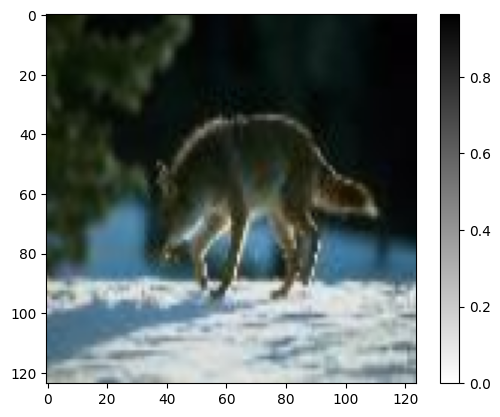

In [ ]:
numimage=15
plt.figure()
plt.imshow(X_train_fox[numimage], cmap=plt.cm.binary)
plt.colorbar()
plt.grid(False)

img3 = cv2.cvtColor(X_train_fox[numimage], cv2.COLOR_BGR2RGB)
plt.imshow (img3)
my_image=img3

# extension des dimensions pour manipuler une seule image
my_image = np.expand_dims(X_train_fox[numimage], axis=0)

In [ ]:
# Le nombre de couches
print ("Le modèle a :", len(model_features.layers), " couches\n")

# Format des données d'entrée du modèle
print ("Input du modèle : ", model_features.input)

# Nom des couches
layer_names = [layer.name for layer in model_features.layers]
print ("\nNom des couches : ", layer_names)

# format des couches
print ("\nFormat des différentes couches : ")
for i in range(len(model_features.layers)):
    layer = model_features.layers[i]
    print("format du layer [", i ,"] : ", layer.name , layer.output.shape)

Le modèle a : 6  couches

Input du modèle :  KerasTensor(type_spec=TensorSpec(shape=(None, 124, 124, 3), dtype=tf.float32, name='Conv2D_1_input'), name='Conv2D_1_input', description="created by layer 'Conv2D_1_input'")

Nom des couches :  ['Conv2D_1', 'Maxpooling2D_1', 'flatten', 'dense', 'dropout', 'dense_1']

Format des différentes couches : 
format du layer [ 0 ] :  Conv2D_1 (None, 122, 122, 32)
format du layer [ 1 ] :  Maxpooling2D_1 (None, 61, 61, 32)
format du layer [ 2 ] :  flatten (None, 119072)
format du layer [ 3 ] :  dense (None, 100)
format du layer [ 4 ] :  dropout (None, 100)
format du layer [ 5 ] :  dense_1 (None, 1)


In [ ]:
list_layer_conv=[0,1]

# Selection des couches correspondant aux convolutions
outputs = [model_features.layers[i].output for i in list_layer_conv]
feature_maps_model = tf.keras.models.Model(inputs=model_features.inputs , outputs=outputs)

feature_maps=feature_maps_model.predict(my_image)


1/1 [==============================] - 0s 53ms/step


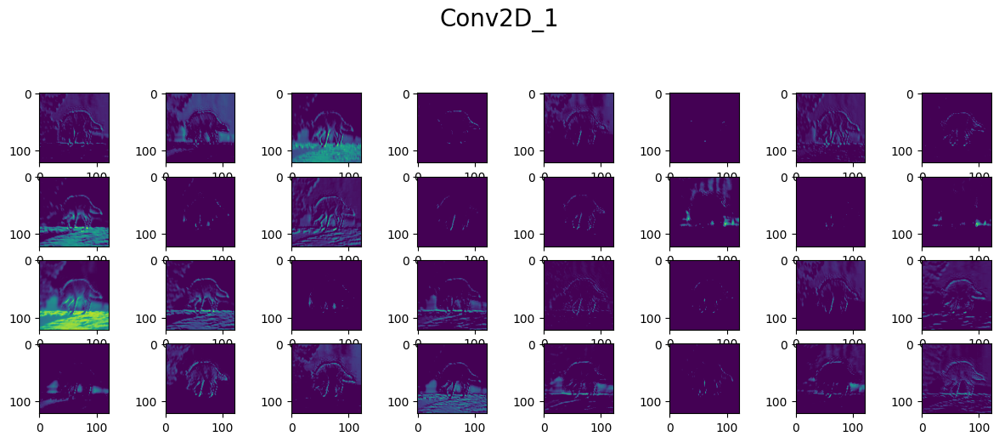

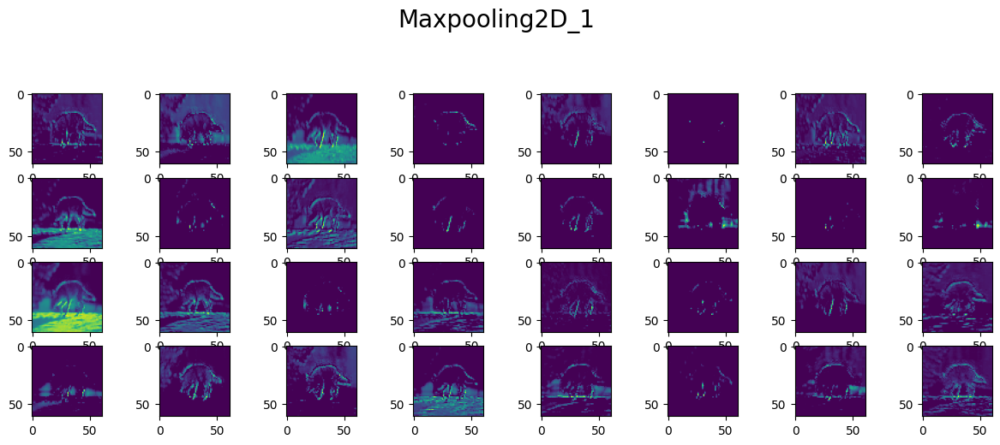

In [ ]:
for i,fmap in zip(list_layer_conv,feature_maps):
    fig = plt.figure(figsize=(15,10))
    fig.suptitle(layer_names[i] , fontsize=20)
    for i in range(1,33):
        plt.subplot(8,8,i)
        plt.imshow(fmap[0,:,:,i-1])
plt.show()

# **GAN**

La génération d'images à l'aide des Réseaux Générateurs Antagonistes (GAN) est une approche novatrice qui permet de créer des contenus visuels réalistes. Dans cette section, nous explorons l'utilisation d'un GAN pour sélectionner des données liées aux renards et générer des images qui capturent au mieux leur apparence distinctive.

### Definition du generateur

In [ ]:
# Defintion du generateur
import numpy as np
from numpy import expand_dims
from numpy import zeros
from numpy import ones
from numpy import vstack
from numpy.random import randn
from numpy.random import randint
from keras.datasets.mnist import load_data
from tensorflow.keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers import Flatten
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Dropout,Activation
from keras.layers import UpSampling2D
from matplotlib import pyplot
from tensorflow.keras.layers import Dense, BatchNormalization
import tensorflow as tf
import matplotlib.pyplot as plt

In [ ]:
def create_generator(latent_dim=100):
    model = Sequential()
    n_nodes = 31 * 31 * 3 * 128

    model.add(Dense(n_nodes,activation="relu",input_dim=latent_dim))
    model.add(Reshape((31, 31, 3*128)))

    model.add(UpSampling2D())
    model.add(Conv2D(3*128,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(UpSampling2D())
    model.add(Conv2D(3*128,kernel_size=3,padding="same"))
    model.add(BatchNormalization(momentum=0.8))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(3,kernel_size=3,padding="same"))
    model.add(Activation('sigmoid'))

    generator_optimizer = tf.keras.optimizers.Adam(1.5e-4,0.5)
    model.compile(loss='binary_crossentropy', optimizer=generator_optimizer, metrics=['accuracy'])
    return model

In [ ]:
generator_model=create_generator()
generator_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 369024)            37271424  
                                                                 
 reshape (Reshape)           (None, 31, 31, 384)       0         
                                                                 
 up_sampling2d (UpSampling2  (None, 62, 62, 384)       0         
 D)                                                              
                                                                 
 conv2d (Conv2D)             (None, 62, 62, 384)       1327488   
                                                                 
 batch_normalization (Batch  (None, 62, 62, 384)       1536      
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 62, 62, 384)       0

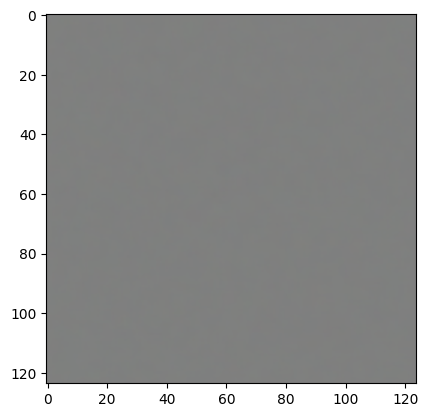

In [ ]:
latent_dim=100
generator = create_generator()
noise=tf.random.normal([1,latent_dim])
generated_image = generator(noise, training=False)
plt.imshow(generated_image[0, :, :, :])

### Discriminator


In [ ]:
def create_discriminator():
  model = Sequential()
  model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same', input_shape=[124,124,3]))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.3))
  model.add(Conv2D(64, (3,3), strides=(2, 2), padding='same'))
  model.add(LeakyReLU(alpha=0.2))
  model.add(Dropout(0.3))
  model.add(Flatten())
  model.add(Dense(1, activation='sigmoid'))
  opt = Adam(learning_rate=0.0002, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
  return model

In [ ]:
model_discriminator=create_discriminator()
model_discriminator.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_43 (Conv2D)          (None, 62, 62, 64)        1792      
                                                                 
 leaky_re_lu_32 (LeakyReLU)  (None, 62, 62, 64)        0         
                                                                 
 dropout_10 (Dropout)        (None, 62, 62, 64)        0         
                                                                 
 conv2d_44 (Conv2D)          (None, 31, 31, 64)        36928     
                                                                 
 leaky_re_lu_33 (LeakyReLU)  (None, 31, 31, 64)        0         
                                                                 
 dropout_11 (Dropout)        (None, 31, 31, 64)        0         
                                                                 
 flatten_5 (Flatten)         (None, 61504)           

In [ ]:
# Chargement et normalisation des données
def load_data():
  my_path = "Data_Project/Tiger-Fox-Elephant/"
  my_classes_tiger = ['selected_fox']
  X_train, y = create_X_y(my_path, my_classes_tiger)
  # Normalisation
  X = X_train.astype('float32')
  X = X / 255.0
  # plot_examples(X_train, y)
  return X, y

# Creation d'un jeu de données de vraies images
# les vraies images sont labélisées avec 1
def generate_real_samples(dataset, nb_images):
	# tirage aléatoire
	ix = randint(0, dataset.shape[0], nb_images)
	X = dataset[ix]
	# mettre 1 comme label de classe
	y = ones((nb_images, 1))
	return X, y

# Création d'un faux jeu de données
# elles seront labélisées avec 0
def generate_fake_samples(nb_images):
  # generation de nombres aléatoires entre 0 et 1
  X = np.random.rand(124 * 124 * 3 * nb_images)
  # reshape en images couleur
  X = X.reshape((nb_images, 124, 124, 3))
  # mettre 0 comme label de classe
  y = zeros((nb_images, 1))
  return X, y

In [ ]:
# Entraînement du discriminateur
def train_discriminator(model, dataset, epochs=100, batchsize=200):
  # on constitue un jeu de données de batchsize/2 images réelles et images fausses
	half_batch = int(batchsize / 2)
	# boucler sur les epochs
	for i in range(epochs):
		# sélection d'images réelles
		X_real, y_real = generate_real_samples(dataset, half_batch)
		# mettre à jour le discriminateur avec les images réelles
		_, real_acc = model.train_on_batch(X_real, y_real)
		# generation de fausses images
		X_fake, y_fake = generate_fake_samples(half_batch)
		# mise à jour du discriminateur avec de fausses images
		_, fake_acc = model.train_on_batch(X_fake, y_fake)
		# Affichage des résultats pour l'accuracy des vraies et des fausses
		print('>%d accuracy_real=%.0f%% accuracy_fake=%.0f%%' % (i+1, real_acc*100, fake_acc*100))

In [ ]:
nb_images_total=150 # 100 images de chaque classe
epochs=100
# chargement du modèle
model = create_discriminator()
# chargement des données
dataset, _ = load_data()
# lancement de l'entrainement du discriminateur
train_discriminator(model, dataset, epochs, nb_images_total)

>1 accuracy_real=81% accuracy_fake=0%
>2 accuracy_real=99% accuracy_fake=3%
>3 accuracy_real=56% accuracy_fake=43%
>4 accuracy_real=4% accuracy_fake=92%
>5 accuracy_real=1% accuracy_fake=99%
>6 accuracy_real=0% accuracy_fake=100%
>7 accuracy_real=0% accuracy_fake=100%
>8 accuracy_real=0% accuracy_fake=100%
>9 accuracy_real=0% accuracy_fake=97%
>10 accuracy_real=3% accuracy_fake=99%
>11 accuracy_real=3% accuracy_fake=100%
>12 accuracy_real=5% accuracy_fake=100%
>13 accuracy_real=8% accuracy_fake=100%
>14 accuracy_real=7% accuracy_fake=100%
>15 accuracy_real=8% accuracy_fake=100%
>16 accuracy_real=8% accuracy_fake=100%
>17 accuracy_real=21% accuracy_fake=100%
>18 accuracy_real=25% accuracy_fake=100%
>19 accuracy_real=24% accuracy_fake=100%
>20 accuracy_real=43% accuracy_fake=100%
>21 accuracy_real=43% accuracy_fake=100%
>22 accuracy_real=44% accuracy_fake=100%
>23 accuracy_real=65% accuracy_fake=100%
>24 accuracy_real=73% accuracy_fake=100%
>25 accuracy_real=63% accuracy_fake=100%
>26 ac

### Definition du gan

In [ ]:
def create_gan(generator_model, discriminator_model):
  # mettre les poids du discriminateur non entrable
  discriminator_model.trainable = False
  # un seul modele qui regroupe
  model = Sequential()
  # ajout du générateur
  model.add(generator_model)
  # ajout du discriminateur
  model.add(discriminator_model)

  opt = Adam(learning_rate=0.0003, beta_1=0.5)
  model.compile(loss='binary_crossentropy', optimizer=opt)
  return model

In [ ]:
latent_dim = 100

# creation du générateur
generator_model = create_generator(latent_dim)
# creation du discriminateur
discriminator_model = create_discriminator()

# creation du gan
gan_model = create_gan(generator_model, discriminator_model)
gan_model.summary()

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_26 (Sequential)  (None, 124, 124, 3)       39939843  
                                                                 
 sequential_27 (Sequential)  (None, 1)                 100225    
                                                                 
Total params: 40040068 (152.74 MB)
Trainable params: 39938307 (152.35 MB)
Non-trainable params: 101761 (397.50 KB)
_________________________________________________________________


In [ ]:
import numpy as np
from matplotlib import pyplot
from numpy import zeros

def generate_latent_points(latent_dim, nb_images):
    X_input = np.random.randn(latent_dim * nb_images)
    X_input = X_input.reshape(nb_images, latent_dim)
    return X_input

def generate_fake_samples_for_generator(generator_model, latent_dim, nb_images):
    # generation des points
    X_input = generate_latent_points(latent_dim, nb_images)
    # prediction de la sortie du générateur
    X = generator_model.predict(X_input)
    # A ce niveau on considère que les images sont fausses
    # donc on met 0 comme label.
    y = zeros((nb_images, 1))
    return X, y

def plot_and_save_generatedimages(generated_images, epoch, nb_images=10):
    # Affichage des images
    for i in range(nb_images * nb_images):
        pyplot.subplot(nb_images, nb_images, 1 + i)
        pyplot.axis('off')
        # pyplot.imshow(generated_images[i, :, :, :])
        pyplot.imshow((generated_images[i] * 127.5 + 127.5).astype('uint8'))
    # sauvegarde de l'image
    filename = 'generated_plot_FoxCNN_withGan%03d.png' % epoch
    pyplot.savefig(filename)
    pyplot.close()

def evaluate_model(dataset, epoch, generator_model, discriminator_model, latent_dim, nb_images=100, save_model=True):
    # récupération de vraies images pour le discriminateur
    X_real, y_real = generate_real_samples(dataset, nb_images)
    # Evaluation de l'accuracy pour le discriminateur
    _, acc_real = discriminator_model.evaluate(X_real, y_real, verbose=0)

    # génération de fausses images pour le générateur et donc le gan
    X_fake, y_fake = generate_fake_samples_for_generator(generator_model, latent_dim, nb_images)
    # Evaluation du discriminateur avec des fausses images
    _, acc_fake = discriminator_model.evaluate(X_fake, y_fake, verbose=0)

    print('Accuracy reélle : %.0f%%, fausse : %.0f%%' % (acc_real * 100, acc_fake * 100))

    plot_and_save_generatedimages(X_fake, epoch)
    if save_model == True:
        # sauvegarde du generateur pour un autre usage
        filename = 'generator_model_Fox%03d.h5' % epoch
        generator_model.save(filename)


In [ ]:
# Entraînement du générateur et du discriminateur
def train(generator_model, discriminator_model, gan_model, dataset, latent_dim, epochs=100, batchsize=256):
  # Pour déterminer combien il y aura de batchs analysés à chaque epoch
  batches_per_epoch = int(dataset.shape[0] / batchsize)

  # pour récupérer le même nombre d'images fausses et vraies
  half_batch = int(batchsize / 2)

  for i in range(epochs):
    # parcours des batches pour chaque pas d'epoch
    for j in range(batches_per_epoch):

      # PARTIE DISCRIMINATOR
      #tirage aléatoire de half_batch images vraies
      X_real, y_real = generate_real_samples(dataset, half_batch)
      # generation de half_size fausses images
      X_fake, y_fake = generate_fake_samples_for_generator(generator_model, latent_dim, half_batch)
      # vstack permet de concaténer les vraies et fausses images dans X (resp. dans y)
      # on aurait pu utiliser np.concatenate (np.concatenate([X_real, X_fake]))
      X, y = vstack((X_real, X_fake)), vstack((y_real, y_fake))

      # la ligne suivante permet au discriminateur de mettre à jour ses poids
      # attention dans le GAN il ne peut pas aprendre donc il ne peut le faire qu'ici
      discriminator_loss,_  = discriminator_model.train_on_batch(X, y)

      # PARTIE GENERATOR ET DONC DE L'ENTREE DU GAN
      # Création des points comme entrée du générateur
      #
      X_for_gan = generate_latent_points(latent_dim, batchsize)
      # On met un 1 pour les labels des fausses images pour faire croire au discriminateur
      # qu'il s'agit de vraies images
      y_for_gan = ones((batchsize, 1))

      # mise à jour des poids du générateur par propagation de l'esseur
      # du discriminateur
      gan_loss = gan_model.train_on_batch(X_for_gan, y_for_gan)
			# Affichage des pertes
      print('epoch %d - batch %d/%d, discriminator_loss=%.3f, generator_loss=%.3f'%(i+1, j+1, batches_per_epoch, discriminator_loss, gan_loss))

    # Toutes les 20 epochs evaluation du modèle et sauvegarde du générateur
    if i==99:
        evaluate_model (dataset, i+1, generator_model, discriminator_model, latent_dim)


In [ ]:
latent_dim = 100
epochs=200
batchsize=10
# Creation du discriminateur
discriminator_model = create_discriminator()
# Creation du generateur
generator_model = create_generator(latent_dim)
# Creation du GAN
gan_model = create_gan(generator_model, discriminator_model)
# Chargement des données
dataset, _ = load_data()

In [ ]:
# Entraînement du modèle
train(generator_model, discriminator_model, gan_model, dataset, latent_dim, epochs, batchsize)

1/1 [==============================] - 2s 2s/step
epoch 1 - batch 1/9, discriminator_loss=0.697, generator_loss=0.868
1/1 [==============================] - 0s 26ms/step
epoch 1 - batch 2/9, discriminator_loss=0.686, generator_loss=0.713
1/1 [==============================] - 0s 28ms/step
epoch 1 - batch 3/9, discriminator_loss=0.683, generator_loss=0.724
1/1 [==============================] - 0s 26ms/step
epoch 1 - batch 4/9, discriminator_loss=0.723, generator_loss=0.672
1/1 [==============================] - 0s 25ms/step
epoch 1 - batch 5/9, discriminator_loss=0.715, generator_loss=0.361
1/1 [==============================] - 0s 25ms/step
epoch 1 - batch 6/9, discriminator_loss=0.712, generator_loss=0.313
1/1 [==============================] - 0s 18ms/step
epoch 1 - batch 7/9, discriminator_loss=0.700, generator_loss=0.394
1/1 [==============================] - 0s 18ms/step
epoch 1 - batch 8/9, discriminator_loss=0.700, generator_loss=0.440
1/1 [==============================] - 0s 

In [ ]:
model = load_model('generator_model_Fox100.h5')

1/1 [==============================] - 0s 92ms/step


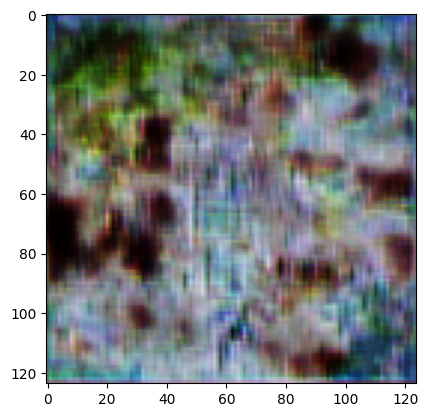

In [ ]:
latent_points = generate_latent_points(100, 1)
generated_image = model.predict(latent_points)
plt.imshow (generated_image[0, :, :])

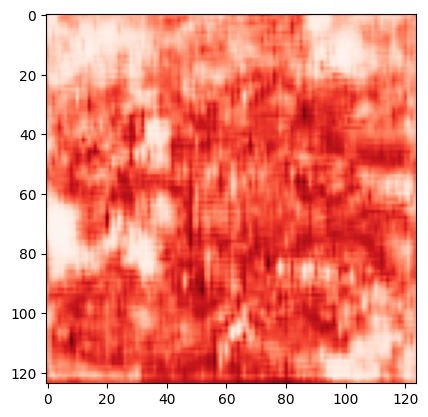

In [ ]:
plt.imshow (generated_image[0, :, :, 0], cmap='Reds')

In [ ]:
X_increase, y_increase = load_data()

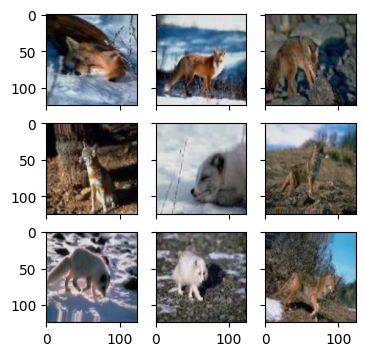

In [ ]:
# Essais de paramétrage sur ImageDataGenerator
datagen = ImageDataGenerator(rotation_range=10, width_shift_range=0.1, horizontal_flip=True)
# configuration du batch size et récupération d'un batch d'images
for X_batch, y_batch in datagen.flow(X_increase, y_increase, batch_size=9, shuffle=True):
    # Affichage de 3x3
    fig, ax = plt.subplots(3, 3, sharex=True, sharey=True, figsize=(4,4))
    for i in range(3):
        for j in range(3):
            img = cv2.resize(X_batch[i*3+j], (124, 124))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            ax[i][j].imshow(img)
    plt.show()
    break

In [ ]:
# Augmentation du dataset avec nos paramètres définitifs
# A N'EXECUTER QU'UNE SEULE FOIS
datagen1 = ImageDataGenerator(horizontal_flip=True, vertical_flip=False, rotation_range=10, width_shift_range=0.05, height_shift_range=0.05, fill_mode='wrap', zoom_range=[0.8,1.1])
nb_images = 1000

# Première vague: 1000 images au total
for X_batch, y_batch in datagen1.flow(X_increase, y_increase, batch_size=1, shuffle=False):
    # Resize for augmentation
    X_batch[0] = X_batch[0]*255
    X_batch = cv2.resize(X_batch[0], (124, 124))
    cv2.imwrite(f"augmented_generated_fox/augmented_{nb_images}.jpg", X_batch)
    nb_images += 1
    if nb_images >= 2000:
      break

SyntaxError: ignored

In [ ]:
def load_augmented_data():
  my_path = "."
  my_classes_tiger = ['augmented_generated_fox']
  X_train, y = create_X_y(my_path, my_classes_tiger)
  # Normalisation
  X = X_train.astype('float32')
  X = X / 255.0
  plot_examples(X_train, y)
  return X, y

>1 accuracy_real=20% accuracy_fake=0%
>2 accuracy_real=99% accuracy_fake=0%
>3 accuracy_real=82% accuracy_fake=19%
>4 accuracy_real=44% accuracy_fake=58%
>5 accuracy_real=37% accuracy_fake=75%
>6 accuracy_real=46% accuracy_fake=83%
>7 accuracy_real=56% accuracy_fake=89%
>8 accuracy_real=67% accuracy_fake=92%
>9 accuracy_real=72% accuracy_fake=96%
>10 accuracy_real=79% accuracy_fake=99%
>11 accuracy_real=82% accuracy_fake=100%
>12 accuracy_real=88% accuracy_fake=100%
>13 accuracy_real=93% accuracy_fake=100%
>14 accuracy_real=95% accuracy_fake=100%
>15 accuracy_real=97% accuracy_fake=100%
>16 accuracy_real=99% accuracy_fake=100%


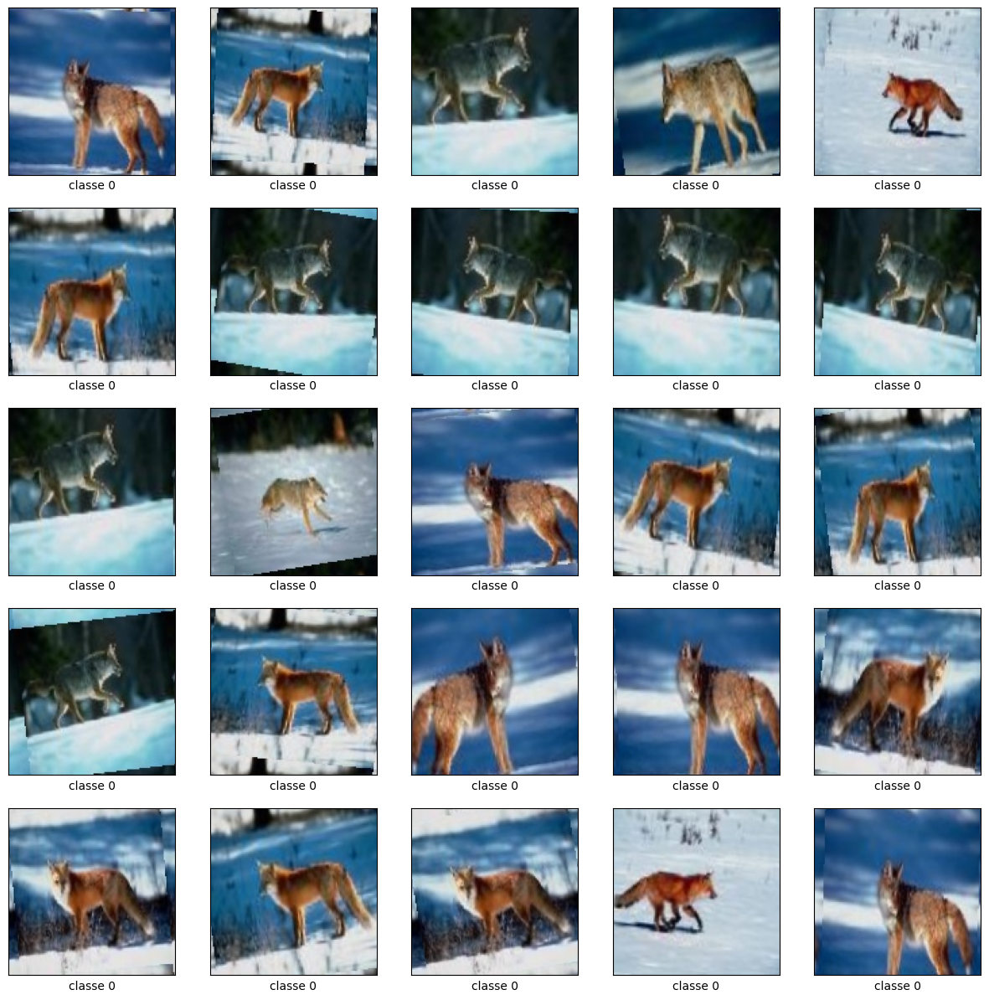

In [ ]:
nb_images_total=2000 # 1000 images de chaque classe
epochs=16

# chargement du modèle
model = create_discriminator()

# chargement des données
dataset, _ = load_augmented_data()

# lancement de l'entrainement du discriminateur
train_discriminator(model, dataset, epochs, nb_images_total)

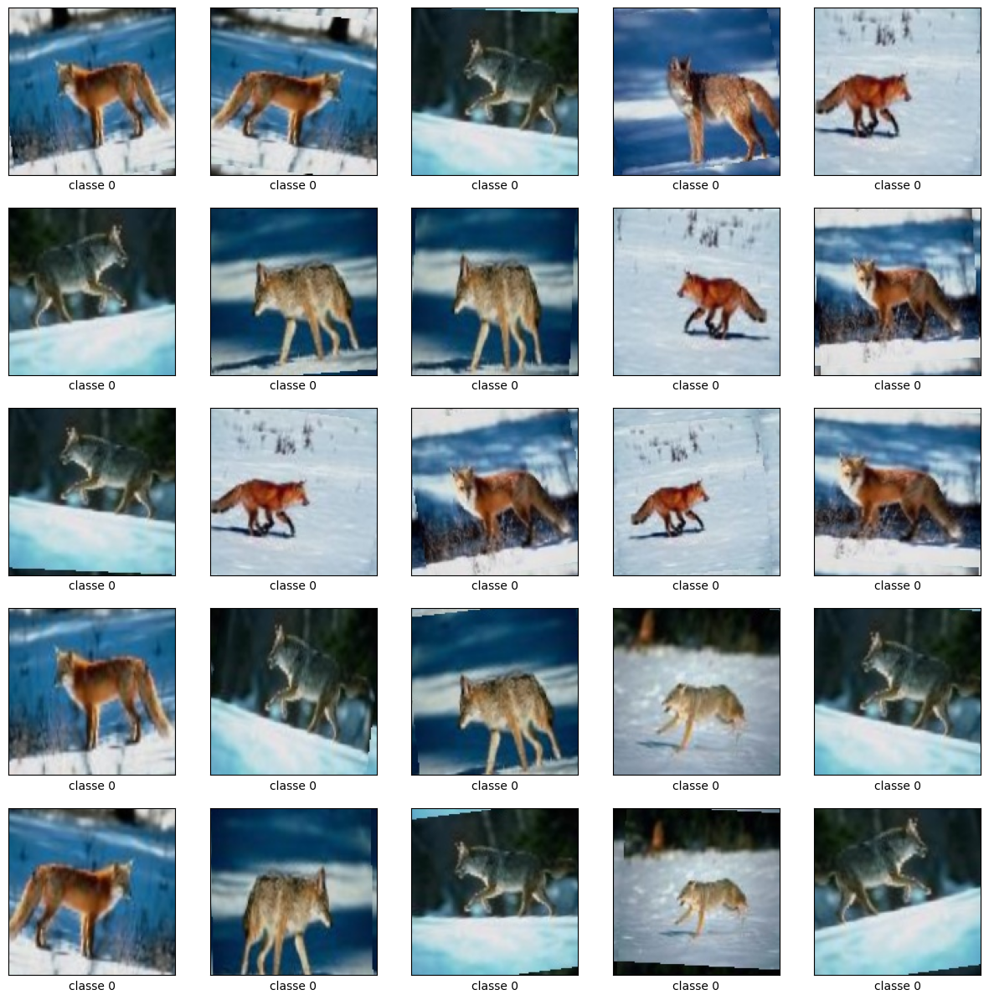

In [ ]:
latent_dim = 100
epochs=600
batchsize=32
# Creation du discriminateur
discriminator_model = create_discriminator()
# Creation du generateur
generator_model = create_generator(latent_dim)
# Creation du GAN
gan_model = create_gan(generator_model, discriminator_model)
# Chargement des données
dataset, _ = load_augmented_data()

In [ ]:
# Entraînement du générateur et du discriminateur
def save_train(generator_model, discriminator_model, gan_model, dataset, latent_dim, epochs=100, batchsize=256, save_interval=10):
    # Définition des chemins pour sauvegarder les modèles
    checkpoint_path_generator = 'Gan_save/generator_model.h5'
    checkpoint_path_discriminator = 'Gan_save/discriminator_model.h5'
    checkpoint_path_epoch = 'Gan_save/last_epoch.txt'

    # Chargement du dernier état des modèles si existant
    start_epoch = 0
    if os.path.exists(checkpoint_path_generator):
        generator_model.load_weights(checkpoint_path_generator)
        discriminator_model.load_weights(checkpoint_path_discriminator)
        with open(checkpoint_path_epoch, 'r') as file:
            start_epoch = int(file.read())
        print("Reprise de l'entraînement à l'époque", start_epoch)

    # Pour déterminer combien il y aura de batchs analysés à chaque epoch
    batches_per_epoch = int(dataset.shape[0] / batchsize)

    # pour récupérer le même nombre d'images fausses et vraies
    half_batch = int(batchsize / 2)

    for i in range(start_epoch, epochs):
        for j in range(batches_per_epoch):
            # PARTIE DISCRIMINATOR
            # tirage aléatoire de half_batch images vraies
            X_real, y_real = generate_real_samples(dataset, half_batch)
            # generation de half_size fausses images
            X_fake, y_fake = generate_fake_samples_for_generator(generator_model, latent_dim, half_batch)
            # vstack permet de concaténer les vraies et fausses images dans X (resp. dans y)
            # on aurait pu utiliser np.concatenate (np.concatenate([X_real, X_fake]))
            X, y = vstack((X_real, X_fake)), vstack((y_real, y_fake))

            # la ligne suivante permet au discriminateur de mettre à jour ses poids
            # attention dans le GAN il ne peut pas apprendre donc il ne peut le faire qu'ici
            discriminator_loss, _ = discriminator_model.train_on_batch(X, y)

            # PARTIE GENERATOR ET DONC DE L'ENTREE DU GAN
            # Création des points comme entrée du générateur
            X_for_gan = generate_latent_points(latent_dim, batchsize)
            # On met un 1 pour les labels des fausses images pour faire croire au discriminateur
            # qu'il s'agit de vraies images
            y_for_gan = ones((batchsize, 1))

            # mise à jour des poids du générateur par propagation de l'esseur
            # du discriminateur
            gan_loss = gan_model.train_on_batch(X_for_gan, y_for_gan)

            # Affichage des pertes
            print('epoch %d - batch %d/%d, discriminator_loss=%.3f, generator_loss=%.3f' % (i + 1, j + 1, batches_per_epoch, discriminator_loss, gan_loss))

        if (i + 1) % save_interval == 0:
            generator_model.save_weights(checkpoint_path_generator)
            discriminator_model.save_weights(checkpoint_path_discriminator)
            with open(checkpoint_path_epoch, 'w') as file:
                file.write(str(i + 1))
            print('Sauvegarde des poids du modèle à l\'époque %d' % (i + 1))

        if (i + 1) % 20 == 0:
            evaluate_model(dataset, i + 1, generator_model, discriminator_model, latent_dim)


In [ ]:
# Entraînement du modèle sur les données augmentées
save_train(generator_model, discriminator_model, gan_model, dataset, latent_dim, epochs, batchsize)

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
1/1 [==============================] - 0s 23ms/step
epoch 19 - batch 25/31, discriminator_loss=0.700, generator_loss=0.657
1/1 [==============================] - 0s 18ms/step
epoch 19 - batch 26/31, discriminator_loss=0.695, generator_loss=0.659
1/1 [==============================] - 0s 24ms/step
epoch 19 - batch 27/31, discriminator_loss=0.694, generator_loss=0.664
1/1 [==============================] - 0s 17ms/step
epoch 19 - batch 28/31, discriminator_loss=0.694, generator_loss=0.662
1/1 [==============================] - 0s 17ms/step
epoch 19 - batch 29/31, discriminator_loss=0.695, generator_loss=0.658
1/1 [==============================] - 0s 22ms/step
epoch 19 - batch 30/31, discriminator_loss=0.698, generator_loss=0.653
1/1 [==============================] - 0s 19ms/step
epoch 19 - batch 31/31, discriminator_loss=0.694, generator_loss=0.660
1/1 [==============================] - 0s 22ms/step
epoch 20 

In [ ]:
model = load_model('generator_model_Fox940.h5')

1/1 [==============================] - 1s 1s/step


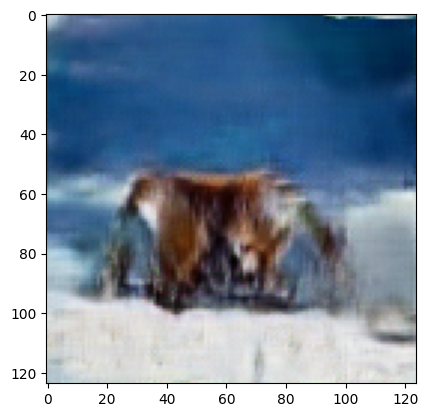

In [ ]:
latent_points = generate_latent_points(100, 1)
generated_image = model.predict(latent_points)

img = cv2.cvtColor(generated_image[0, :, :], cv2.COLOR_BGR2RGB)
plt.imshow (img)

In [ ]:
plt.imsave("fox_generator/fox1.png",img)

1/1 [==============================] - 1s 1s/step


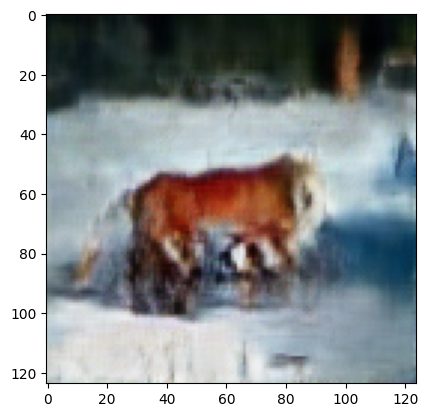

In [ ]:
latent_points = generate_latent_points(100, 1)
generated_image = model.predict(latent_points)

img2 = cv2.cvtColor(generated_image[0, :, :], cv2.COLOR_BGR2RGB)
plt.imshow (img2)

1/1 [==============================] - 1s 959ms/step


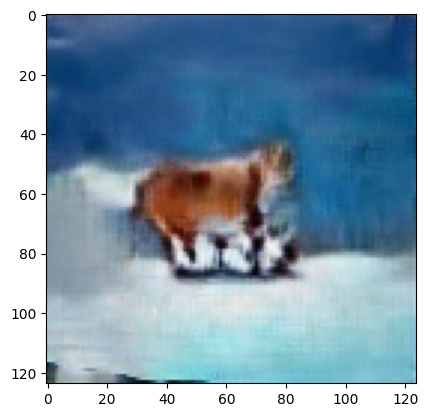

In [ ]:
latent_points = generate_latent_points(100, 1)
generated_image = model.predict(latent_points)

img4 = cv2.cvtColor(generated_image[0, :, :], cv2.COLOR_BGR2RGB)
plt.imshow (img4)

In [ ]:
latent_points = generate_latent_points(100, 1)
generated_image = model.predict(latent_points)

img5 = cv2.cvtColor(generated_image[0, :, :], cv2.COLOR_BGR2RGB)
plt.imshow (img5)

1/1 [==============================] - 2s 2s/step


In [ ]:
plt.imsave("fox_generator/fox7.png",img5)

1/1 [==============================] - 1s 966ms/step


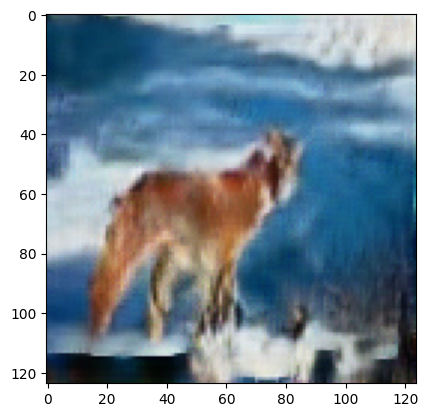

In [ ]:
latent_points = generate_latent_points(100, 1)
generated_image = model.predict(latent_points)

img3 = cv2.cvtColor(generated_image[0, :, :], cv2.COLOR_BGR2RGB)
plt.imshow (img3)

In [ ]:
X_train, y_train, X_test, y_test = load_my_dataset(X_fox, y_fox)

In [ ]:
model, base_model = create_exception_model()

datagen = ImageDataGenerator(rotation_range=0.2, horizontal_flip=True, vertical_flip=True)


batches = datagen.flow(X_train, y_train, batch_size=32)


history = model.fit(batches, epochs=30, batch_size=32,
                            validation_data=(X_test, y_test), verbose=1)


base_model.trainable = True
model.summary(show_trainable=True)

model.compile(optimizer=keras.optimizers.Adam(1e-5), loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])

history2 = model.fit(batches, epochs=10,
                            validation_data=(X_test, y_test), verbose=1)



Epoch 1/30
5/5 [==============================] - 18s 724ms/step - loss: 0.7778 - accuracy: 0.4906 - val_loss: 0.8763 - val_accuracy: 0.4250
Epoch 2/30
5/5 [==============================] - 1s 140ms/step - loss: 0.7296 - accuracy: 0.5723 - val_loss: 0.6875 - val_accuracy: 0.5750
Epoch 3/30
5/5 [==============================] - 1s 136ms/step - loss: 0.6111 - accuracy: 0.6415 - val_loss: 0.4685 - val_accuracy: 0.9000
Epoch 4/30
5/5 [==============================] - 1s 145ms/step - loss: 0.5754 - accuracy: 0.6667 - val_loss: 0.4315 - val_accuracy: 0.9500
Epoch 5/30
5/5 [==============================] - 1s 146ms/step - loss: 0.4694 - accuracy: 0.8616 - val_loss: 0.4380 - val_accuracy: 0.9250
Epoch 6/30
5/5 [==============================] - 1s 142ms/step - loss: 0.4667 - accuracy: 0.8050 - val_loss: 0.4088 - val_accuracy: 0.9250
Epoch 7/30
5/5 [==============================] - 1s 138ms/step - loss: 0.4223 - accuracy: 0.8742 - val_loss: 0.3490 - val_accuracy: 0.9500
Epoch 8/30
5/5 [===

In [ ]:
# Ici on load 10 images générées par le GAN
my_path="./"
my_classes=['fox_generator']

def create2_X_y (path_data, list_classes):
      # récupération des données
      training_data=create_training_data(path_data, list_classes)
      # tri des données
      random.shuffle(training_data)
      # création de X et y
      X=[]
      y=[]
      for features, label in training_data:
        X.append(features)
        y.append(label)
      X=np.array(X)
      y=np.array(y)
      return X,y

X,y=create2_X_y(my_path, my_classes)


In [ ]:
X = X[:, :, :, :3]

In [ ]:
X=X.astype('float32')
X/=255.0

In [ ]:
X.shape

(11, 124, 124, 3)

In [ ]:
y.shape

(11,)

1/1 [==============================] - 0s 38ms/step
Prediction du modèle : 


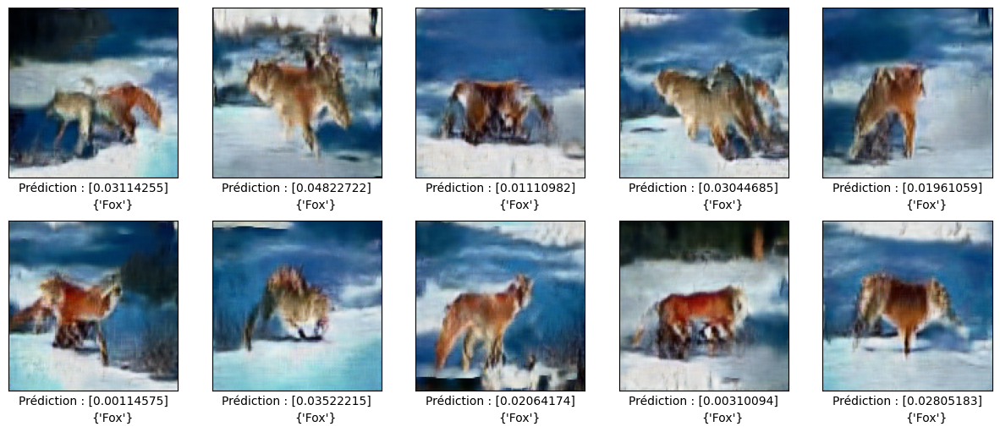

In [ ]:
prediction = model.predict(X,verbose=1)
print('Prediction du modèle : ')
plt.figure(figsize=(15,6))
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    img = cv2.cvtColor(X[i], cv2.COLOR_BGR2RGB)
    plt.imshow(img,cmap=plt.cm.binary)
    plt.xlabel('Prédiction : ' + str(prediction[i]))
    is_fox = prediction[i] < 0.5
    plt.text(60,146,{'Fox' if is_fox else 'Not fox'})

# **Coloration d’images avec un autoencoders**

In [ ]:
DATA_FOLDER = "Data_Project/Tiger-Fox-Elephant"
NUM_IMAGES=len(os.listdir(DATA_FOLDER))
EPOCH=25
WEIGHTS_FOLDER = "Data_Project/Tiger-Fox-Elephant/WeightsTiger"
if not os.path.exists(WEIGHTS_FOLDER):
  print("Creating folder")
  os.makedirs(os.path.join(WEIGHTS_FOLDER))

In [ ]:
from glob import glob

filenames = np.array(glob(os.path.join(DATA_FOLDER+'/tiger', '*.jpg')))
NUM_IMAGES = len(filenames)
print("Total number of images : " + str(NUM_IMAGES))

INPUT_DIM = (128,128,3)
BATCH_SIZE = 10
Z_DIM = 200

data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(DATA_FOLDER,
                                                                  classes=['tiger'],
                                                                   target_size = INPUT_DIM[:2],
                                                                   batch_size = BATCH_SIZE,
                                                                   shuffle = True,
                                                                   seed=42,
                                                                   class_mode = 'input'
                                                                   )

Total number of images : 100
Found 100 images belonging to 1 classes.


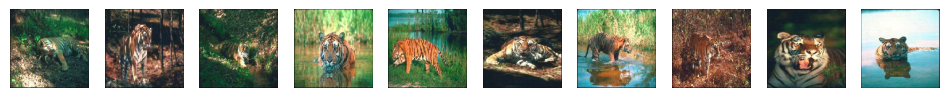

In [ ]:
data_batch = next(data_flow)

# Plot des 10 premières images du batch
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 10, figsize=(12, 6))
for i, ax in enumerate(axes.flatten()):
    ax.imshow(data_batch[0][i])
    ax.axis('off')
plt.show()

## Definition de l'auto-encoder

In [ ]:
from keras import backend as K
from tensorflow.keras.layers import Input, Conv2D, LeakyReLU, Flatten, Dense
from tensorflow.keras.models import Model

K = tf.keras.backend

def build_encoder(input_dim, output_dim):

  global K
  K.clear_session()

  # entrée du modèle
  encoder_input = Input(shape = input_dim, name = 'encoder_input')
  x = encoder_input

  # Convolution 1
  x= Conv2D(filters = 32,
            kernel_size = 3,
            strides = 2,
            padding = 'same', name = 'encoder_conv_1')(x)
  # Activation
  x = LeakyReLU()(x)

  # Convolution 2
  x= Conv2D(filters = 64,
            kernel_size = 3,
            strides = 2,
            padding = 'same', name = 'encoder_conv_2')(x)
  # Activation
  x = LeakyReLU()(x)

  # Convolution 3
  x= Conv2D(filters = 64,
            kernel_size = 3,
            strides = 2,
            padding = 'same', name = 'encoder_conv_3')(x)
  # Activation
  x = LeakyReLU()(x)

   # Convolution 4
  x= Conv2D(filters = 64,
            kernel_size = 3,
            strides = 2,
            padding = 'same', name = 'encoder_conv_4')(x)
  # Activation
  x = LeakyReLU()(x)


  # Forme de l'entrée (que l'on renverra)
  shape_before_flattening = K.int_shape(x)[1:]

  # Aplatissement
  x = Flatten()(x)

  # Sortie de l'encodeur
  encoder_output = Dense(output_dim, name = 'encoder_output')(x)

  return encoder_input, encoder_output, shape_before_flattening, Model(encoder_input, encoder_output)

In [ ]:
encoder_input, encoder_output,  shape_before_flattening, encoder  = build_encoder(input_dim = INPUT_DIM,
                                    output_dim = Z_DIM,
                                    )

encoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_input (InputLayer)  [(None, 128, 128, 3)]     0         
                                                                 
 encoder_conv_1 (Conv2D)     (None, 64, 64, 32)        896       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64, 64, 32)        0         
                                                                 
 encoder_conv_2 (Conv2D)     (None, 32, 32, 64)        18496     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 encoder_conv_3 (Conv2D)     (None, 16, 16, 64)        36928     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 16, 16, 64)        0     

In [ ]:
from tensorflow.keras.layers import Input, Dense, Reshape, Conv2DTranspose, LeakyReLU, Activation
from tensorflow.keras.models import Model
import numpy as np

def build_decoder(input_dim, shape_before_flattening):
  # Entrée du modèle
  decoder_input = Input(shape = (input_dim,) , name = 'decoder_input')

  # Image miroir de l'encodeur
  x = Dense(np.prod(shape_before_flattening))(decoder_input)
  x = Reshape(shape_before_flattening)(x)

  # Conv2DTranspose 1
  x = Conv2DTranspose(filters = 64,
                  kernel_size = 3,
                  strides = 2,
                  padding = 'same',
                  name = 'decoder_conv_1'
                  )(x)
  # Activation
  x = LeakyReLU()(x)

  # Conv2DTranspose 2
  x = Conv2DTranspose(filters = 64,
                  kernel_size = 3,
                  strides = 2,
                  padding = 'same',
                  name = 'decoder_conv_2'
                  )(x)
  # Activation
  x = LeakyReLU()(x)

  # Conv2DTranspose 3
  x = Conv2DTranspose(filters = 32,
                  kernel_size = 3,
                  strides = 2,
                  padding = 'same',
                  name = 'decoder_conv_3'
                  )(x)
  # Activation
  x = LeakyReLU()(x)

  # Conv2DTranspose 4
  x = Conv2DTranspose(filters = 3,
                  kernel_size = 3,
                  strides = 2,
                  padding = 'same',
                  name = 'decoder_conv_4'
                  )(x)
  # Activation
  x = Activation('sigmoid')(x)

  # Sortie du décodeur
  decoder_output = x

  return decoder_input, decoder_output, Model(decoder_input, decoder_output)

In [ ]:
decoder_input, decoder_output, decoder = build_decoder(input_dim = Z_DIM,
                                        shape_before_flattening = (8, 8, 64)
                                        )
decoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 decoder_input (InputLayer)  [(None, 200)]             0         
                                                                 
 dense (Dense)               (None, 4096)              823296    
                                                                 
 reshape (Reshape)           (None, 8, 8, 64)          0         
                                                                 
 decoder_conv_1 (Conv2DTran  (None, 16, 16, 64)        36928     
 spose)                                                          
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 decoder_conv_2 (Conv2DTran  (None, 32, 32, 64)        36928     
 spose)                                                    

In [ ]:
autoencoder = Model(encoder_input, decoder(encoder_output))
autoencoder.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_input (InputLayer)  [(None, 128, 128, 3)]     0         
                                                                 
 encoder_conv_1 (Conv2D)     (None, 64, 64, 32)        896       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64, 64, 32)        0         
                                                                 
 encoder_conv_2 (Conv2D)     (None, 32, 32, 64)        18496     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 encoder_conv_3 (Conv2D)     (None, 16, 16, 64)        36928     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 16, 16, 64)        0   

## **Fonction de traitement**

In [ ]:
def show_images(autoencoder, images=None):
  if images is None:
    example_batch = next(data_flow)
    example_batch = example_batch[0]
    images = example_batch[:10]

  n_to_show = images.shape[0]

  reconst_images = autoencoder.predict(images)

  fig = plt.figure(figsize=(15, 3))
  fig.subplots_adjust(hspace=0.4, wspace=0.4)

  for i in range(n_to_show):
      img = images[i].squeeze()
      sub = fig.add_subplot(2, n_to_show, i+1)
      sub.axis('off')
      sub.imshow(img)

  for i in range(n_to_show):
      img = reconst_images[i].squeeze()
      sub = fig.add_subplot(2, n_to_show, i+n_to_show+1)
      sub.axis('off')
      sub.imshow(img)

In [ ]:
def black_and_white_on_image(image):
    # Convert the image to grayscale
    grayscale_image = image.convert("L")
    # Resize the grayscale image to the desired size (128x128)
    grayscale_image = grayscale_image.resize((128, 128))
    # Convert the grayscale image to a NumPy array for displaying with matplotlib
    image_array = np.array(grayscale_image)
    # Stack the grayscale array to create a 3-channel grayscale image
    image_array = np.stack((image_array,) * 3, axis=-1)
    return image_array

def my_image_generator(folder, classes, target_size, batch_size, typeimage='mask', shuffle=True):
    # typeimage = 'mask' for a "hole" in the image
    # typeimage = 'noise' for adding noise in the image
    # typeimage = 'blackwhite' for having an image in black and white
    # to keep track that you don't have invalid index for number of files

    # Create a list of file paths
    files = []
    for c in classes:
        class_folder = folder + '/' + c
        file_pattern = class_folder + '/*.jpg'  # Update file extension to match your images
        files.extend(glob(file_pattern))

    # Shuffle the list of file paths if shuffle is True
    if shuffle:
        random.shuffle(files)

    # Initialize iteration counter
    iter = 0

    while True:
        # check if you have an invalid index for files, if yes then reset it
        if (iter*batch_size + batch_size) > len(files):
            iter = 0
        end_iter = iter*batch_size + batch_size
        # Select files (paths/indices) for the batch
        paths = files[iter*batch_size:end_iter]
        # Read in each input and perform preprocessing (to batch of images)
        corrupted_images_batch = []
        original_images_batch = []
        for path in paths:
            img = Image.open(path)
            # Get only images with 3 canals
            if img.mode=='RGB':
              # Resize the image using the target_size parameter
              img = img.resize(target_size, resample=Image.BILINEAR)

              original_images_batch.append(np.array(img)/255)

              # Check the size of the image

              if img.size[0] == target_size[0] and img.size[1] == target_size[1]:
                if typeimage == 'blackwhite':
                    changed_img = black_and_white_on_image(img)

              else:
                  print("L'image {} n'a pas les dimensions appropriées.".format(path))

              preprocess_img = np.array(changed_img)
              corrupted_images_batch.append(preprocess_img/255)
            else:
              continue
        # Return a tuple of (corrupted_image_batch, true_image_batch) to feed the network
        corrupted_images_batch = np.array(corrupted_images_batch)
        original_images_batch = np.array(original_images_batch)
        # Move to the next batch
        iter = iter + 1

        yield (corrupted_images_batch, original_images_batch)

In [ ]:
# display some images, typeimage is used for blackandwhite images because otherwise images will be in green ... matplotlib issue.
def display_images_from_batch(batch, typeimage):
    corrupted_images = batch[0][:8] # Extract the first 8 corrupted images from batch
    original_images = batch[1][:8] # Extract the first 8 original images from batchh

    fig, axs = plt.subplots(8, 2, figsize=(12, 24))
    fig.tight_layout(pad=3.0)

    for i in range(8):
        axs[i, 0].imshow(original_images[i].squeeze()) # Original image in first column
        axs[i, 0].set_title('Originale')
        axs[i, 0].axis('off')
        if typeimage=='blackwhite':
          axs[i, 1].imshow(corrupted_images[i].squeeze(),cmap='gray' )
        else:
          axs[i, 1].imshow(corrupted_images[i].squeeze()) # Corrupted image in the second column
        axs[i, 1].set_title('Noir & Blanc')
        axs[i, 1].axis('off')

    plt.show()

Entrainement de l'auto-encodeur

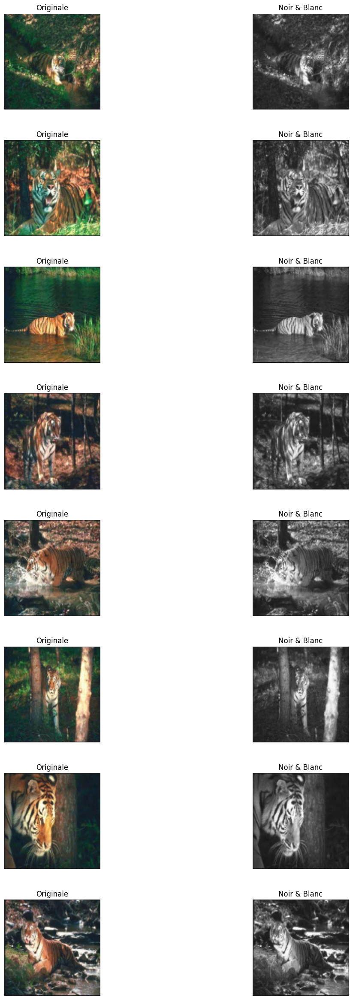

In [ ]:
BATCH_SIZE = 10
INPUT_DIM = (128,128,3)
classes=['tiger']
target_size=INPUT_DIM[:2]
typeimage='blackwhite'
# Create the generator
mydataflow=my_image_generator(folder=DATA_FOLDER, classes=classes, target_size=target_size,batch_size=BATCH_SIZE, typeimage=typeimage)

# Get a batch
batch = next(mydataflow)
display_images_from_batch(batch,typeimage )

In [ ]:
# parameters of the model
LEARNING_RATE=.0005
steps_per_epoch=int(NUM_IMAGES / BATCH_SIZE)
EPOCHS=100

In [ ]:
tf.config.run_functions_eagerly(True)

autoencoder.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE), loss='mean_squared_error' , metrics=['accuracy'])

# Create a validation data for plotting
# Getting the first batch
val_data_flow = next(mydataflow)

checkpoint_autoencoder = ModelCheckpoint(os.path.join(WEIGHTS_FOLDER, 'NBweights.h5'), save_weights_only = True, verbose=1)
history=autoencoder.fit(mydataflow,
                      shuffle=True,
                      epochs = EPOCHS,
                      initial_epoch = 0,
                      steps_per_epoch=steps_per_epoch,
                      validation_data=val_data_flow,
                      callbacks=[checkpoint_autoencoder])

Epoch 1/100
10/10 [==============================] - ETA: 0s - loss: 0.0631 - accuracy: 0.3949
Epoch 1: saving model to Data_Project/Tiger-Fox-Elephant/WeightsTiger/NBweights.h5
10/10 [==============================] - 6s 238ms/step - loss: 0.0631 - accuracy: 0.3949 - val_loss: 0.0649 - val_accuracy: 0.4352
Epoch 2/100
10/10 [==============================] - ETA: 0s - loss: 0.0624 - accuracy: 0.4208
Epoch 2: saving model to Data_Project/Tiger-Fox-Elephant/WeightsTiger/NBweights.h5
10/10 [==============================] - 1s 139ms/step - loss: 0.0624 - accuracy: 0.4208 - val_loss: 0.0638 - val_accuracy: 0.4352
Epoch 3/100
10/10 [==============================] - ETA: 0s - loss: 0.0604 - accuracy: 0.4167
Epoch 3: saving model to Data_Project/Tiger-Fox-Elephant/WeightsTiger/NBweights.h5
10/10 [==============================] - 1s 137ms/step - loss: 0.0604 - accuracy: 0.4167 - val_loss: 0.0538 - val_accuracy: 0.4214
Epoch 4/100
10/10 [==============================] - ETA: 0s - loss: 0.05

## **Jeu de données augmenté**

In [ ]:
def load_data():
  my_path = "Data_Project/Tiger-Fox-Elephant/"
  my_classes_tiger = ['tiger']
  X_train, y = create_X_y(my_path, my_classes_tiger)
  # Normalisation
  X = X_train.astype('float32')
  X = X / 255.0
  plot_examples(X_train, y)
  return X, y

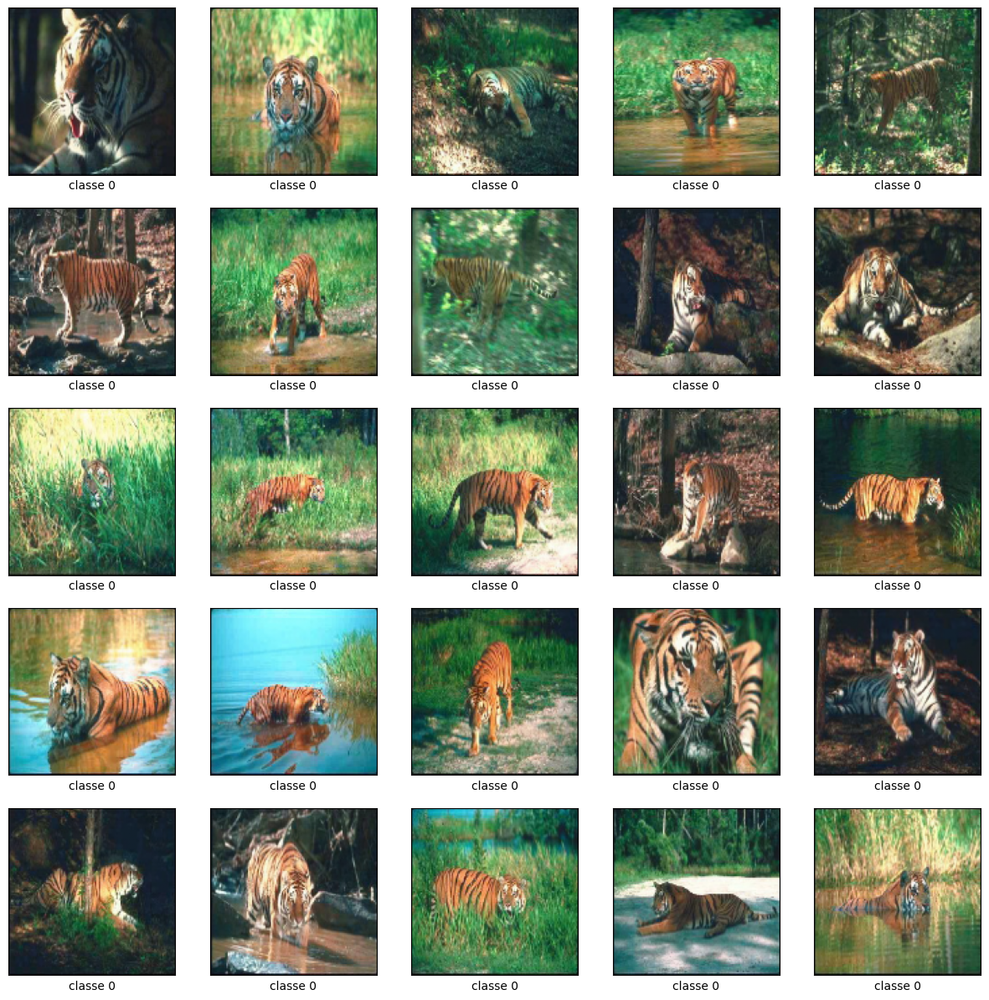

In [ ]:
# Chargement des données à augmenter
X_increase, y_increase = load_data()

In [ ]:
# A executer que si on a pas donner dans le dossier
datagen = ImageDataGenerator(horizontal_flip=True,
                              vertical_flip=False,
                              rotation_range=10,
                              width_shift_range=0.05,
                              height_shift_range=0.05,
                              fill_mode='wrap',
                              zoom_range=[0.8,1.1])
nb_images = 1000
nbr=0
for X_batch, y_batch in datagen.flow(X_increase, y_increase, batch_size=1, shuffle=False):
    # Resize for augmentation
    X_batch[0] = X_batch[0]*255
    X_batch = cv2.resize(X_batch[0], (124, 124))
    cv2.imwrite(f"augmented_tiger/augmented_{nbr}.jpg", X_batch)
    nbr += 1
    if nbr >= 1000:
      break

In [ ]:
DATA_FOLDER_AUGMENTED = "."
NUM_IMAGES_AUGMENTED=len(os.listdir(DATA_FOLDER_AUGMENTED))
EPOCH=25
WEIGHTS_FOLDER_AUGMENTED = "augmented_tiger/WeightsAugmentedTiger"
if not os.path.exists(WEIGHTS_FOLDER_AUGMENTED):
  print("Creating folder")
  os.makedirs(os.path.join(WEIGHTS_FOLDER_AUGMENTED))

In [ ]:
filenames_augmented = np.array(glob(os.path.join(DATA_FOLDER_AUGMENTED+'/augmented_tiger', '*.jpg')))
NUM_IMAGES_AUGMENTED = len(filenames_augmented)
print("Total number of images : " + str(NUM_IMAGES_AUGMENTED))

INPUT_DIM = (128,128,3)
BATCH_SIZE = 10
Z_DIM = 200

data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(DATA_FOLDER_AUGMENTED,
                                                                   classes=['augmented_tiger'],
                                                                   target_size = INPUT_DIM[:2],
                                                                   batch_size = BATCH_SIZE,
                                                                   shuffle = True,
                                                                   seed=42,
                                                                   class_mode = 'input'
                                                                   )

Total number of images : 1000
Found 1000 images belonging to 1 classes.


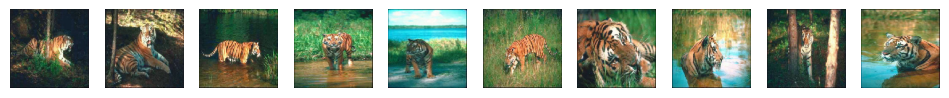

In [ ]:
# Getting the first batch of generated images
data_batch = next(data_flow)

# Plotting the first 10 images of the batch
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 10, figsize=(12, 6))
for i, ax in enumerate(axes.flatten()):
    ax.imshow(data_batch[0][i])
    ax.axis('off')
plt.show()

Instantiation de l'auto-encodeur

In [ ]:
encoder_input, encoder_output,  shape_before_flattening, encoder  = build_encoder(input_dim = INPUT_DIM,
                                    output_dim = Z_DIM,
                                    )

encoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_input (InputLayer)  [(None, 128, 128, 3)]     0         
                                                                 
 encoder_conv_1 (Conv2D)     (None, 64, 64, 32)        896       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64, 64, 32)        0         
                                                                 
 encoder_conv_2 (Conv2D)     (None, 32, 32, 64)        18496     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 encoder_conv_3 (Conv2D)     (None, 16, 16, 64)        36928     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 16, 16, 64)        0     

In [ ]:
decoder_input, decoder_output, decoder = build_decoder(input_dim = Z_DIM,
                                        shape_before_flattening = (8, 8, 64)
                                        )
decoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 decoder_input (InputLayer)  [(None, 200)]             0         
                                                                 
 dense (Dense)               (None, 4096)              823296    
                                                                 
 reshape (Reshape)           (None, 8, 8, 64)          0         
                                                                 
 decoder_conv_1 (Conv2DTran  (None, 16, 16, 64)        36928     
 spose)                                                          
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 decoder_conv_2 (Conv2DTran  (None, 32, 32, 64)        36928     
 spose)                                                    

In [ ]:
autoencoder_input = encoder_input
autoencoder_output = decoder(encoder_output)
autoencoder = Model(autoencoder_input, autoencoder_output)
autoencoder.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 encoder_input (InputLayer)  [(None, 128, 128, 3)]     0         
                                                                 
 encoder_conv_1 (Conv2D)     (None, 64, 64, 32)        896       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64, 64, 32)        0         
                                                                 
 encoder_conv_2 (Conv2D)     (None, 32, 32, 64)        18496     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 encoder_conv_3 (Conv2D)     (None, 16, 16, 64)        36928     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 16, 16, 64)        0   

Entrainement de l'auto-encodeur

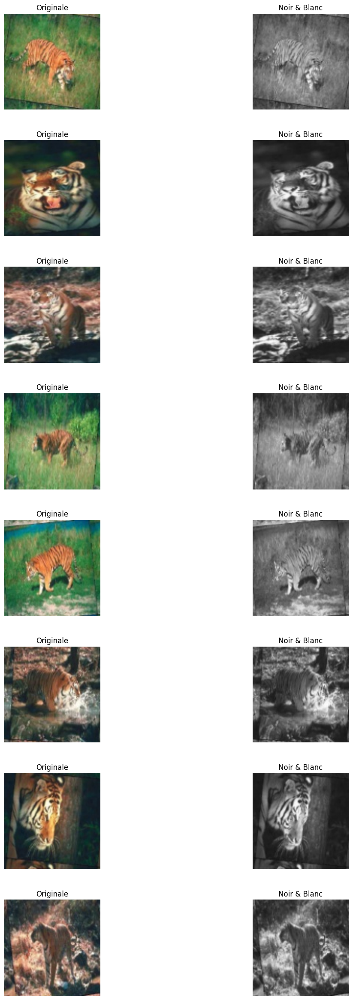

In [ ]:
BATCH_SIZE = 10
INPUT_DIM = (128,128,3)
classes=['augmented_tiger']
target_size=INPUT_DIM[:2]
typeimage='blackwhite'
# Create the generator
mydataflow=my_image_generator(folder=DATA_FOLDER_AUGMENTED, classes=classes, target_size=target_size,batch_size=BATCH_SIZE, typeimage=typeimage)

# Get a batch
batch = next(mydataflow)
display_images_from_batch(batch,typeimage )

In [ ]:
# parameters of the model
LEARNING_RATE=.0005
steps_per_epoch=int(NUM_IMAGES_AUGMENTED / BATCH_SIZE)
EPOCHS=50

In [ ]:
tf.config.run_functions_eagerly(True)
tf.data.experimental.enable_debug_mode()

autoencoder.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE), loss='binary_crossentropy' , metrics=['accuracy'])

# Create a validation data for plotting
# Getting the first batch
val_data_flow = next(mydataflow)

checkpoint_autoencoder = ModelCheckpoint(os.path.join(WEIGHTS_FOLDER_AUGMENTED, 'NBweights.h5'), save_weights_only = True, verbose=1)
history = autoencoder.fit(mydataflow,
                          shuffle=True,
                          epochs=EPOCHS,
                          initial_epoch=0,
                          steps_per_epoch=steps_per_epoch,
                          validation_data=val_data_flow,  # Utilisez votre générateur de lot de validation ici
                          callbacks=[checkpoint_autoencoder])


Epoch 1/50
8/8 [==============================] - ETA: 0s - loss: 0.5728 - accuracy: 0.8237
Epoch 1: saving model to augmented_tiger/WeightsAugmentedTiger/NBweights.h5
8/8 [==============================] - 2s 185ms/step - loss: 0.5728 - accuracy: 0.8237 - val_loss: 0.5524 - val_accuracy: 0.8084
Epoch 2/50
8/8 [==============================] - ETA: 0s - loss: 0.5720 - accuracy: 0.8242
Epoch 2: saving model to augmented_tiger/WeightsAugmentedTiger/NBweights.h5
8/8 [==============================] - 1s 179ms/step - loss: 0.5720 - accuracy: 0.8242 - val_loss: 0.5533 - val_accuracy: 0.7952
Epoch 3/50
8/8 [==============================] - ETA: 0s - loss: 0.5734 - accuracy: 0.8203
Epoch 3: saving model to augmented_tiger/WeightsAugmentedTiger/NBweights.h5
8/8 [==============================] - 1s 186ms/step - loss: 0.5734 - accuracy: 0.8203 - val_loss: 0.5532 - val_accuracy: 0.8174
Epoch 4/50
8/8 [==============================] - ETA: 0s - loss: 0.5704 - accuracy: 0.8097
Epoch 4: saving m

1/1 [==============================] - 0s 41ms/step


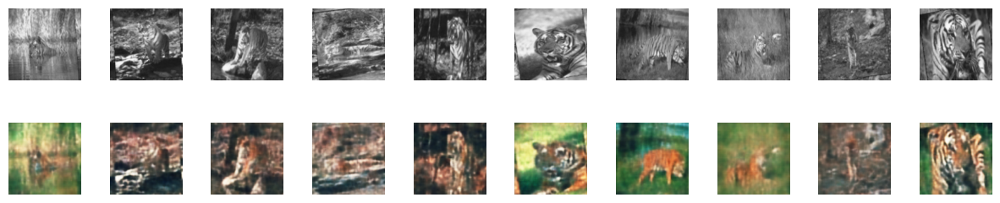

In [ ]:
example_batch = next(mydataflow)
example_batch = example_batch[0]
example_images = example_batch[:10]
show_images(autoencoder,example_images)